<a href="https://colab.research.google.com/github/Alaa-abdelmajied/Image_Segmentation/blob/main/Assignnment2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Load dataset
[Google drive link to download dataset first](https://drive.google.com/drive/folders/1_a7hEo0xMt_Xv0y24TQzPd9tBXhNY_Ab?usp=sharing)

In [ ]:
!unzip data

Archive:  data.zip
replace data/groundTruth/test/100007.mat? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: data/groundTruth/test/100007.mat  
  inflating: data/groundTruth/test/100039.mat  
  inflating: data/groundTruth/test/100099.mat  
  inflating: data/groundTruth/test/10081.mat  
  inflating: data/groundTruth/test/101027.mat  
  inflating: data/groundTruth/test/101084.mat  
  inflating: data/groundTruth/test/102062.mat  
  inflating: data/groundTruth/test/103006.mat  
  inflating: data/groundTruth/test/103029.mat  
  inflating: data/groundTruth/test/103078.mat  
  inflating: data/groundTruth/test/104010.mat  
  inflating: data/groundTruth/test/104055.mat  
  inflating: data/groundTruth/test/105027.mat  
  inflating: data/groundTruth/test/106005.mat  
  inflating: data/groundTruth/test/106047.mat  
  inflating: data/groundTruth/test/107014.mat  
  inflating: data/groundTruth/test/107045.mat  
  inflating: data/groundTruth/test/107072.mat  
  inflating: data/groundTruth/test/1

#Imports

In [ ]:
import os
import cv2
import math
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.io import loadmat
from itertools import product
from sklearn.cluster import KMeans
from sklearn.metrics import precision_score, recall_score, f1_score 
from sklearn.cluster import SpectralClustering

#Visualize image




In [ ]:
def getImages(n):

  images=[]
  counter=0
  path = '/content/data/images/test'
  
  for imageName in os.listdir(path):
    if counter!=n:
        images.append(imageName.replace('.jpg',''))
        counter+=1

  return images

In [ ]:
def displayImage(fileName):
  #Image
  path = '/content/data/images/test'
  imageName = fileName + '.jpg'
  imagePath = os.path.join(path,imageName)
  normalImage = cv2.imread(imagePath)
  normalImage = cv2.cvtColor(normalImage, cv2.COLOR_BGR2RGB)
  plt.figure(figsize=(20,5))
  plt.subplot(1,6,1)
  plt.title('Normal Image')
  plt.imshow(normalImage)
  
  #Ground truth
  path = '/content/data/groundTruth/test'
  imageName = fileName + '.mat'
  imagePath = os.path.join(path,imageName)
  groundTruth = loadmat(imagePath)
  segments = []

  for i in range(5):
    image = np.array(groundTruth['groundTruth'][0][i][0][0][0])
    segments.append(image)
    plt.subplot(1,6,(i+2))
    plt.title('Segment number '+str(i))
    plt.imshow(image)
  plt.show()
  segments = np.array(segments)
  return normalImage,segments

#Segmentation using K-means

In [ ]:
def kmeans_clustering(image,K):

  labels = np.zeros((5,463203))
  dimensions = image.shape
  image = image.reshape((-1, 3))
  image = np.float32(image)

  segmentedImage=np.zeros((len(K),dimensions[0],dimensions[1]))
  idx=0

  for k in K:

    kmeans = KMeans(n_clusters=k, random_state=0).fit(image)
    segmentedImage[idx] = np.array([j for j in kmeans.labels_]).reshape(dimensions[0],dimensions[1])

    # show the image
    plt.title('At k='+str(k)+' clusters (Kmeans clustering)')
    plt.imshow(segmentedImage[idx])
    plt.show()
    idx += 1
    
  return segmentedImage

#F-Measure & Conditional Entropy

In [ ]:
def F_measure(segImg_pred,segments,numberOfClusters,normalizedCut):
  totalAverage=0
  for K, k in zip(numberOfClusters, range(len(segImg_pred))):
    fmeasure_sum=0
    for s in range(len(segments)):
      if normalizedCut:
        segment = cv2.resize(segments[s],None,fx = 0.15,fy = 0.15)
        prec=precision_score(segment.flatten(), segImg_pred[k].flatten(), average='macro',zero_division=1)
        recall=recall_score(segment.flatten(), segImg_pred[k].flatten(), average='macro',zero_division=1) 
      else:
        prec=precision_score(segments[s].flatten(), segImg_pred[k].flatten(), average='macro',zero_division=1)
        recall=recall_score(segments[s].flatten(), segImg_pred[k].flatten(), average='macro',zero_division=1)
      f_measure=(2.0*prec*recall)/(prec+recall)
      fmeasure_sum+=f_measure
      print('F-measure at k:',str(K),' and groundTruth segment:',str(s),' is:',f_measure)
    totalAverage+=fmeasure_sum  
    print('Average at K:',K,' is: ',fmeasure_sum/len(segments))
    print('------------------------------------')
  print('Total Average is: ',totalAverage/(len(numberOfClusters)*len(segments)))
  print('------------------------------------')


In [ ]:
def ConditionalEntropy(segmentedImg,groundTruthSegments,numberOfClusters,normalizedCut):
  condEntropyList = []
  averageTotal=0
  for k,image in zip(numberOfClusters,range(len(segmentedImg))):
    prediction = segmentedImg[image].flatten()
    averageCondEntropy = 0
    for groundTruthIamge in range(groundTruthSegments.shape[0]):
      if normalizedCut:
        groundTruth = cv2.resize(groundTruthSegments[groundTruthIamge],None,fx = 0.15,fy = 0.15)
        groundTruth = groundTruth.flatten()
      else:
        groundTruth = groundTruthSegments[groundTruthIamge].flatten()
      predictedLabels = np.unique(prediction)
      predictionIdx = []
      for label in predictedLabels:
        if np.where(prediction == label)[0].size > 0:
          predictionIdx.append(np.where(prediction == label))
      predictionIdx = np.asarray(predictionIdx,dtype=object)
      clusters = []
      for index in range(len(predictedLabels)):
        clusters.append(np.array([groundTruth[idx] for idx in predictionIdx[index]]))
      clusterProbs  = np.unique(prediction, return_counts=True)[1]/prediction.shape[0]
      contengencyTable = pd.crosstab(prediction,groundTruth)
      total = 0
      groundTruthUnique = np.unique(groundTruth)
      for col in groundTruthUnique:
        total += contengencyTable[col]
      contengencyTable["Total"] = total 
      condEntropy = np.zeros(len(clusters))
      for row in range(contengencyTable.shape[0]):
        condEntropyRow = 0
        for col in groundTruthUnique: 
          if contengencyTable[col][row] != 0:
            condEntropyRow += (-contengencyTable[col][row]/contengencyTable["Total"][row])*np.log2(contengencyTable[col][row]/contengencyTable["Total"][row])
        condEntropy[row] = condEntropyRow*clusterProbs[row]
      averageCondEntropy += sum(condEntropy)
      print('Conditional Entropy at k:',k,' and groundTruth segment:',groundTruthIamge,' is:',sum(condEntropy))
    averageTotal+=averageCondEntropy
    averageCondEntropy /= groundTruthSegments.shape[0]
    print('Average at K:',k,' is: ',averageCondEntropy)
    print('------------------------------------')
  print('Total Average is: ',averageTotal/(len(numberOfClusters)*(groundTruthSegments.shape[0])))
  print('------------------------------------')


#Step 3 results






Image Number: 1  Image: 226060


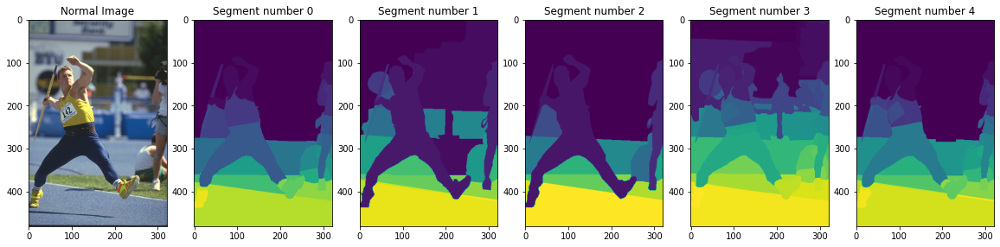

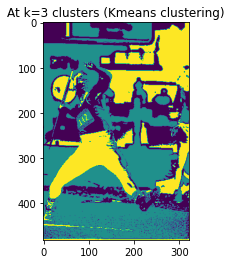

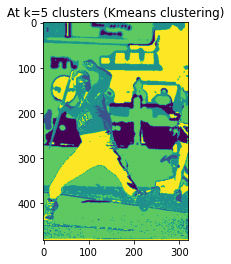

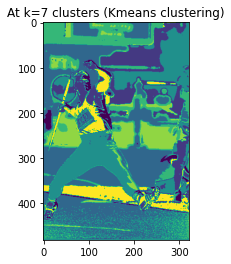

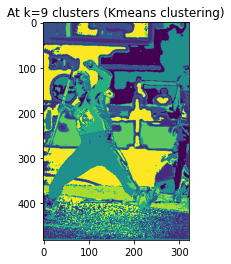

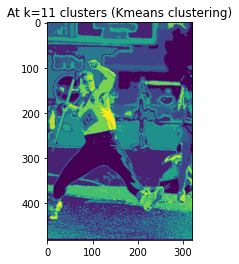

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.07285298097675101
F-measure at k: 3  and groundTruth segment: 1  is: 0.12115701419546393
F-measure at k: 3  and groundTruth segment: 2  is: 0.1692258133975721
F-measure at k: 3  and groundTruth segment: 3  is: 0.07142755046757207
F-measure at k: 3  and groundTruth segment: 4  is: 0.06094332298776531
Average at K: 3  is:  0.09912133640502488
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.0973447137640538
F-measure at k: 5  and groundTruth segment: 1  is: 0.10027252375687502
F-measure at k: 5  and groundTruth segment: 2  is: 0.14313171930122479
F-measure at k: 5  and groundTruth segment: 3  is: 0.048739886975674954
F-measure at k: 5  and groundTruth segment: 4  is: 0.07918829577795455
Average at K: 5  is:  0.09373542791515663
------------------------------------
F-measure at k: 7  and groundTruth 

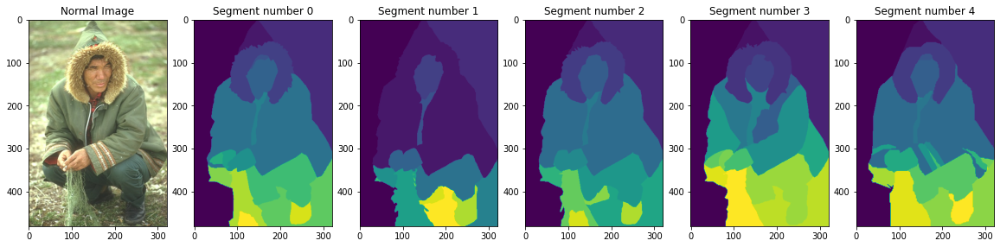

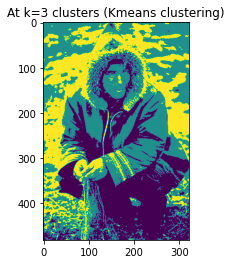

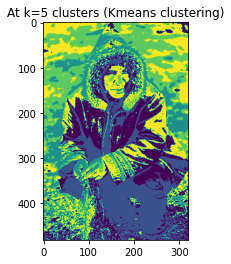

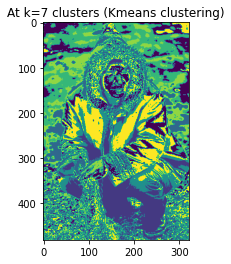

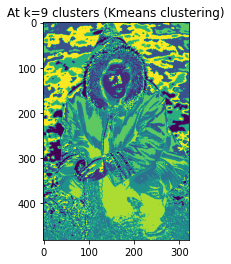

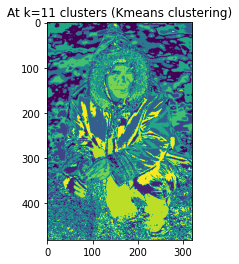

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.200312319892154
F-measure at k: 3  and groundTruth segment: 1  is: 0.16208443193229918
F-measure at k: 3  and groundTruth segment: 2  is: 0.1916655259028911
F-measure at k: 3  and groundTruth segment: 3  is: 0.16681826614831718
F-measure at k: 3  and groundTruth segment: 4  is: 0.15008325620240173
Average at K: 3  is:  0.17419276001561262
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.20826006120496673
F-measure at k: 5  and groundTruth segment: 1  is: 0.1979385126203977
F-measure at k: 5  and groundTruth segment: 2  is: 0.19887072235949296
F-measure at k: 5  and groundTruth segment: 3  is: 0.17460447164075144
F-measure at k: 5  and groundTruth segment: 4  is: 0.15360012287782993
Average at K: 5  is:  0.18665477814068776
------------------------------------
F-measure at k: 7  and groundTruth seg

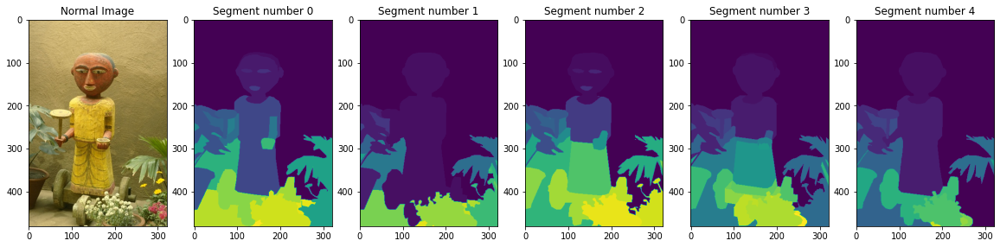

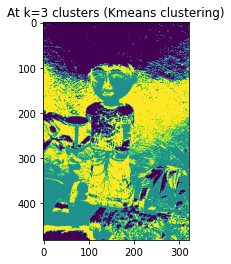

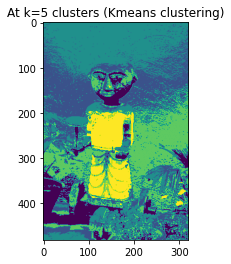

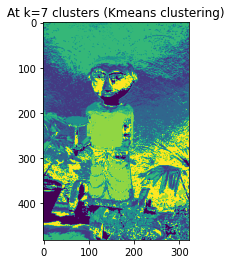

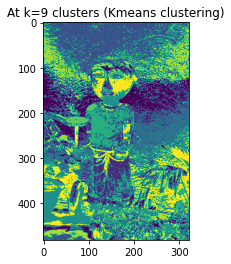

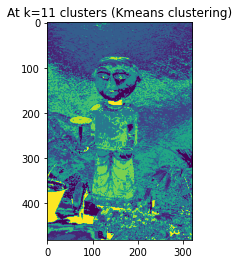

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.08268222711838201
F-measure at k: 3  and groundTruth segment: 1  is: 0.10984834138259823
F-measure at k: 3  and groundTruth segment: 2  is: 0.08614357524571246
F-measure at k: 3  and groundTruth segment: 3  is: 0.06109810878219748
F-measure at k: 3  and groundTruth segment: 4  is: 0.1008523132597197
Average at K: 3  is:  0.08812491315772197
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.14407187079772515
F-measure at k: 5  and groundTruth segment: 1  is: 0.11639935001437557
F-measure at k: 5  and groundTruth segment: 2  is: 0.11628306189976716
F-measure at k: 5  and groundTruth segment: 3  is: 0.1349208956304978
F-measure at k: 5  and groundTruth segment: 4  is: 0.11745386610849376
Average at K: 5  is:  0.12582580889017186
------------------------------------
F-measure at k: 7  and groundTruth s

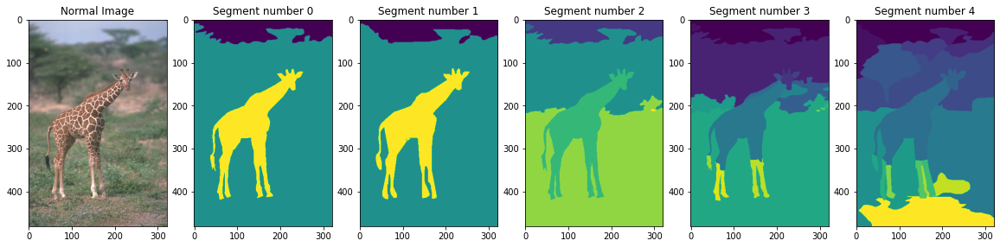

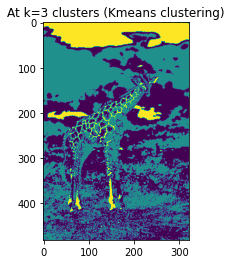

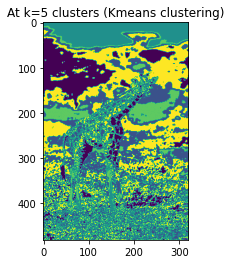

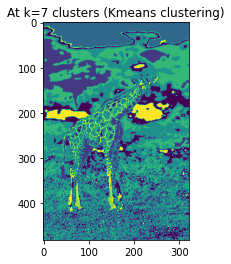

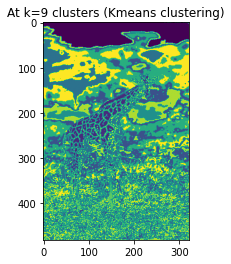

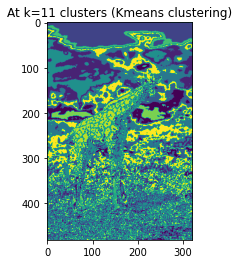

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.2730500298639376
F-measure at k: 3  and groundTruth segment: 1  is: 0.27631125984029864
F-measure at k: 3  and groundTruth segment: 2  is: 0.3642291246063363
F-measure at k: 3  and groundTruth segment: 3  is: 0.09415650197391248
F-measure at k: 3  and groundTruth segment: 4  is: 0.08416063945205389
Average at K: 3  is:  0.2183815111473078
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.09265406019139642
F-measure at k: 5  and groundTruth segment: 1  is: 0.09805622819029208
F-measure at k: 5  and groundTruth segment: 2  is: 0.3944912506567844
F-measure at k: 5  and groundTruth segment: 3  is: 0.1088496474322369
F-measure at k: 5  and groundTruth segment: 4  is: 0.11777365079226458
Average at K: 5  is:  0.16236496745259488
------------------------------------
F-measure at k: 7  and groundTruth segm

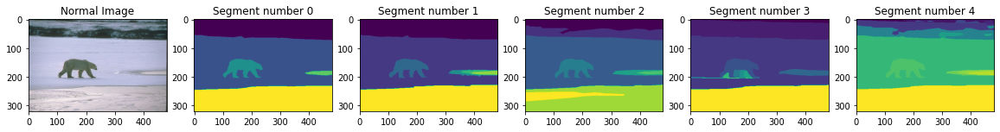

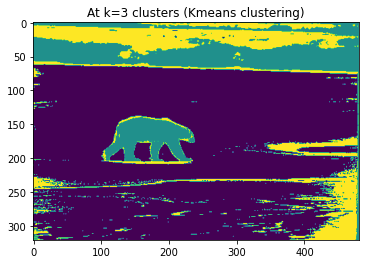

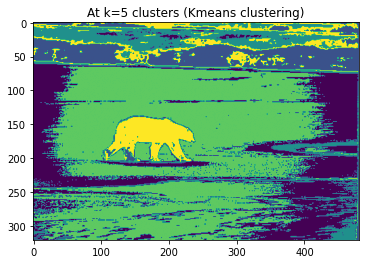

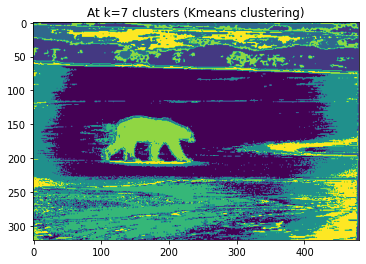

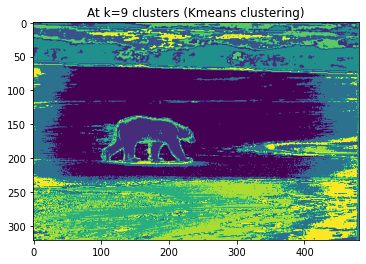

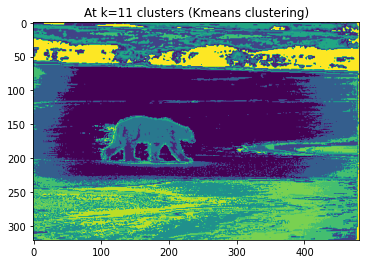

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.3942527576009966
F-measure at k: 3  and groundTruth segment: 1  is: 0.3244506327586582
F-measure at k: 3  and groundTruth segment: 2  is: 0.24380407226232917
F-measure at k: 3  and groundTruth segment: 3  is: 0.24550696055176163
F-measure at k: 3  and groundTruth segment: 4  is: 0.22344076941459637
Average at K: 3  is:  0.28629103851766835
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.29475964513286707
F-measure at k: 5  and groundTruth segment: 1  is: 0.2704441437090668
F-measure at k: 5  and groundTruth segment: 2  is: 0.3915670351833948
F-measure at k: 5  and groundTruth segment: 3  is: 0.34472635303742544
F-measure at k: 5  and groundTruth segment: 4  is: 0.19467159406885967
Average at K: 5  is:  0.29923375422632276
------------------------------------
F-measure at k: 7  and groundTruth seg

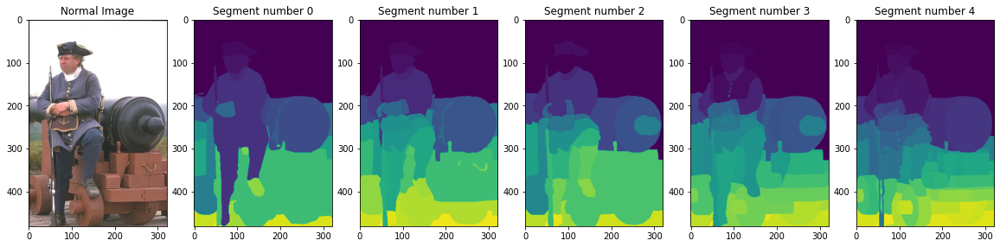

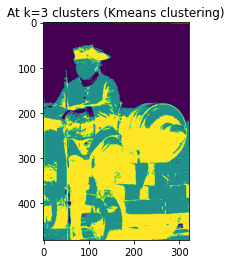

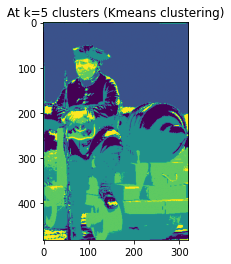

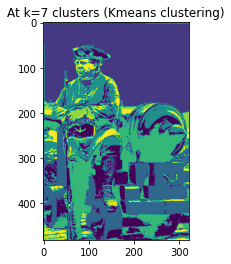

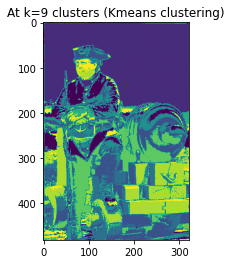

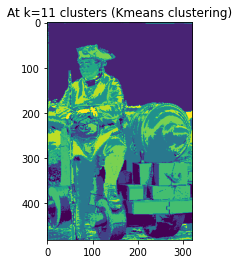

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.08861461581367105
F-measure at k: 3  and groundTruth segment: 1  is: 0.07534297847461244
F-measure at k: 3  and groundTruth segment: 2  is: 0.1120076208086135
F-measure at k: 3  and groundTruth segment: 3  is: 0.054286788020541356
F-measure at k: 3  and groundTruth segment: 4  is: 0.029203733171915817
Average at K: 3  is:  0.07189114725787084
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.16217008639145583
F-measure at k: 5  and groundTruth segment: 1  is: 0.13942917146439468
F-measure at k: 5  and groundTruth segment: 2  is: 0.165689669745258
F-measure at k: 5  and groundTruth segment: 3  is: 0.08370357902089842
F-measure at k: 5  and groundTruth segment: 4  is: 0.04551907888194688
Average at K: 5  is:  0.11930231710079076
------------------------------------
F-measure at k: 7  and groundTruth 

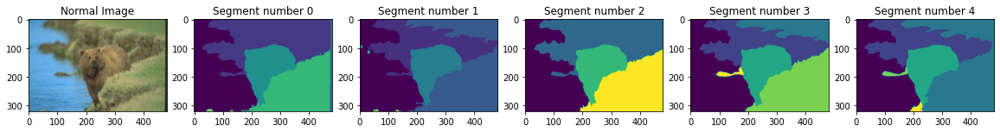

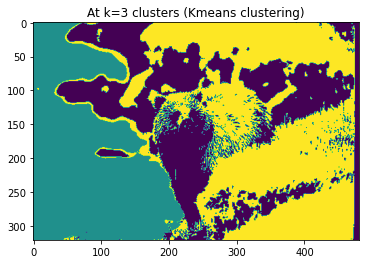

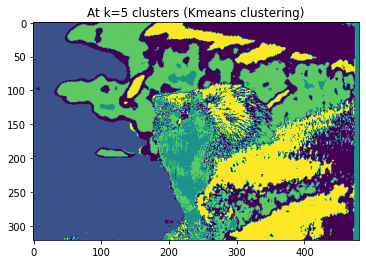

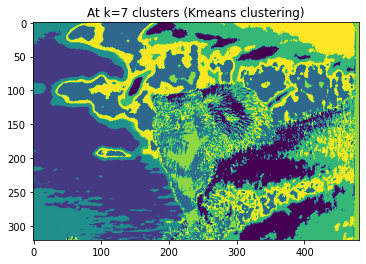

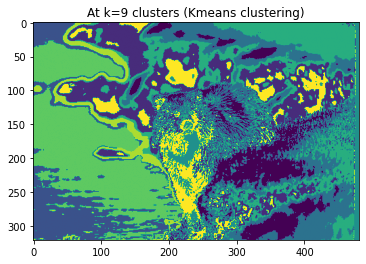

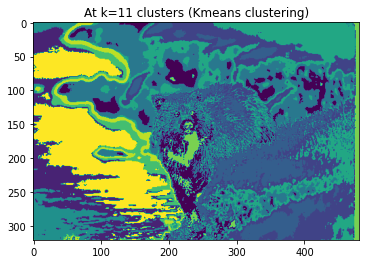

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.43900690685220567
F-measure at k: 3  and groundTruth segment: 1  is: 0.3753205099622398
F-measure at k: 3  and groundTruth segment: 2  is: 0.5597948121199386
F-measure at k: 3  and groundTruth segment: 3  is: 0.4385899953485087
F-measure at k: 3  and groundTruth segment: 4  is: 0.4397348012685037
Average at K: 3  is:  0.45048940511027935
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.37045980248166227
F-measure at k: 5  and groundTruth segment: 1  is: 0.3582725435854053
F-measure at k: 5  and groundTruth segment: 2  is: 0.46780751379131963
F-measure at k: 5  and groundTruth segment: 3  is: 0.3780254044480841
F-measure at k: 5  and groundTruth segment: 4  is: 0.39133597737062925
Average at K: 5  is:  0.3931802483354201
------------------------------------
F-measure at k: 7  and groundTruth segmen

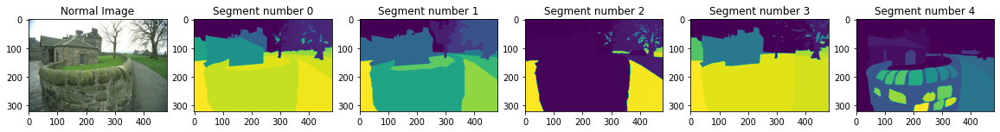

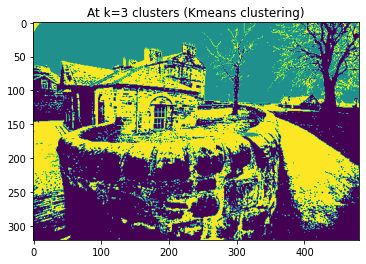

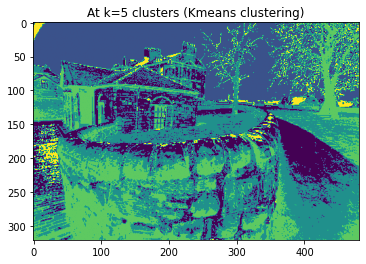

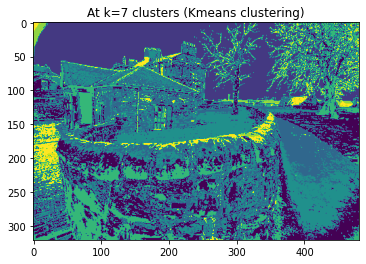

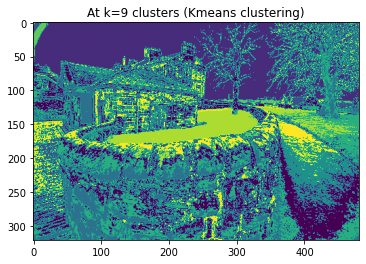

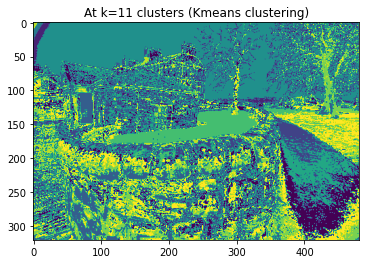

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.0889313479271783
F-measure at k: 3  and groundTruth segment: 1  is: 0.25380739309839845
F-measure at k: 3  and groundTruth segment: 2  is: 0.06119448242295743
F-measure at k: 3  and groundTruth segment: 3  is: 0.09204796133202
F-measure at k: 3  and groundTruth segment: 4  is: 0.13994434536796352
Average at K: 3  is:  0.12718510602970354
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.08736527759003584
F-measure at k: 5  and groundTruth segment: 1  is: 0.2642946832017589
F-measure at k: 5  and groundTruth segment: 2  is: 0.061620740405280545
F-measure at k: 5  and groundTruth segment: 3  is: 0.09937768283144027
F-measure at k: 5  and groundTruth segment: 4  is: 0.1272421994181971
Average at K: 5  is:  0.12798011668934253
------------------------------------
F-measure at k: 7  and groundTruth segm

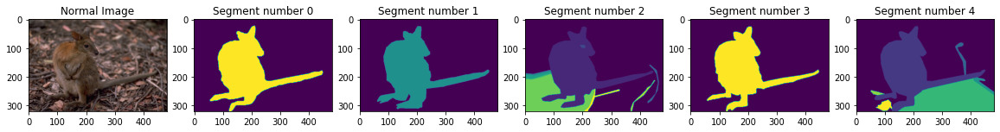

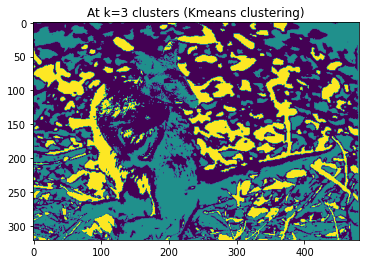

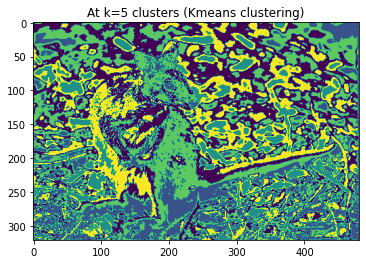

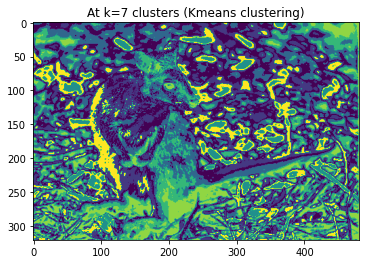

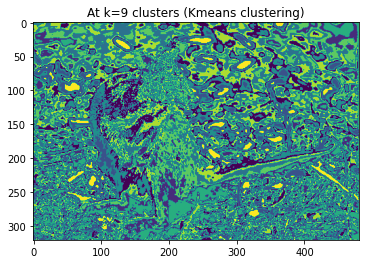

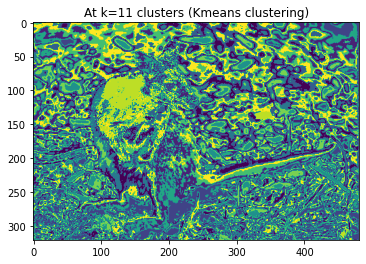

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.3613666886036408
F-measure at k: 3  and groundTruth segment: 1  is: 0.3997390010000704
F-measure at k: 3  and groundTruth segment: 2  is: 0.2186892421360403
F-measure at k: 3  and groundTruth segment: 3  is: 0.3661522102668576
F-measure at k: 3  and groundTruth segment: 4  is: 0.2777508854322579
Average at K: 3  is:  0.32473960548777336
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.26742174868375596
F-measure at k: 5  and groundTruth segment: 1  is: 0.23001789112843243
F-measure at k: 5  and groundTruth segment: 2  is: 0.2787112629712561
F-measure at k: 5  and groundTruth segment: 3  is: 0.28118991445956126
F-measure at k: 5  and groundTruth segment: 4  is: 0.24387989536053845
Average at K: 5  is:  0.2602441425207089
------------------------------------
F-measure at k: 7  and groundTruth segmen

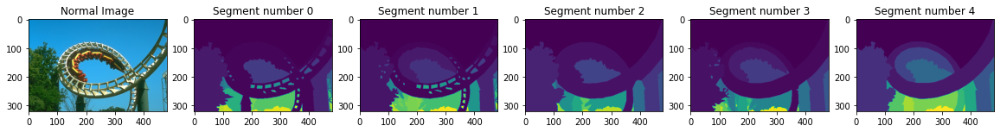

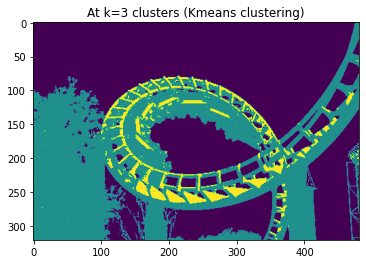

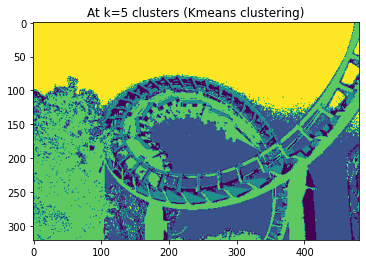

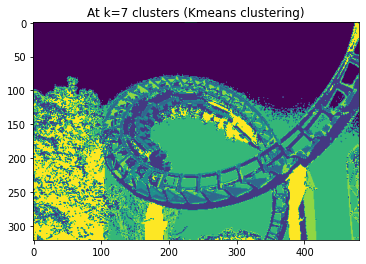

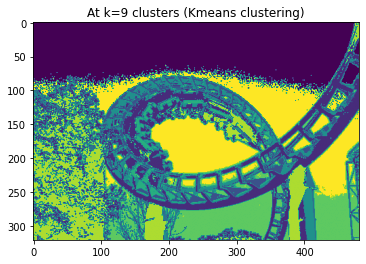

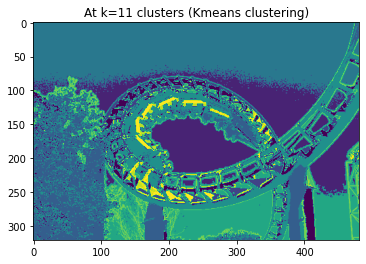

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.04045096859859796
F-measure at k: 3  and groundTruth segment: 1  is: 0.03497166929988652
F-measure at k: 3  and groundTruth segment: 2  is: 0.10341213195754818
F-measure at k: 3  and groundTruth segment: 3  is: 0.05716142890820381
F-measure at k: 3  and groundTruth segment: 4  is: 0.1343670976298058
Average at K: 3  is:  0.07407265927880846
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.0704218925047001
F-measure at k: 5  and groundTruth segment: 1  is: 0.05994484586922054
F-measure at k: 5  and groundTruth segment: 2  is: 0.16988403456510984
F-measure at k: 5  and groundTruth segment: 3  is: 0.0955611950728603
F-measure at k: 5  and groundTruth segment: 4  is: 0.2115685897014341
Average at K: 5  is:  0.12147611154266498
------------------------------------
F-measure at k: 7  and groundTruth seg

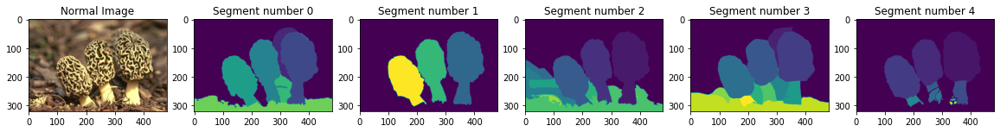

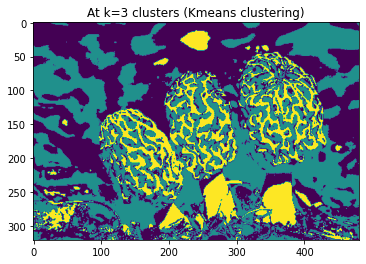

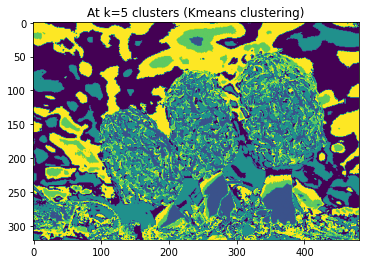

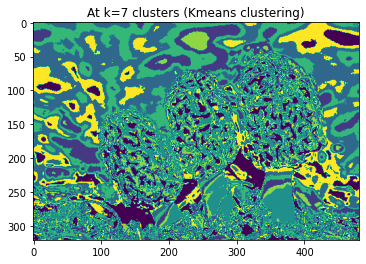

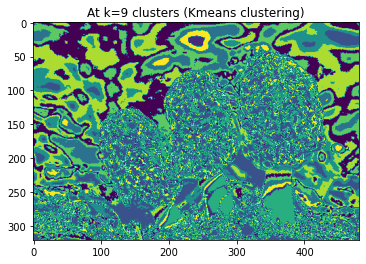

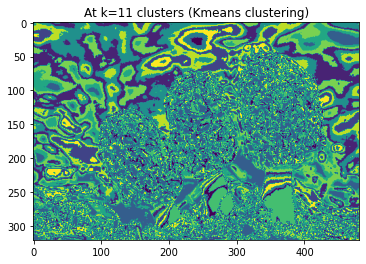

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.22675734896222738
F-measure at k: 3  and groundTruth segment: 1  is: 0.4524119395966049
F-measure at k: 3  and groundTruth segment: 2  is: 0.1997623500521037
F-measure at k: 3  and groundTruth segment: 3  is: 0.19474080918565567
F-measure at k: 3  and groundTruth segment: 4  is: 0.16629137192052165
Average at K: 3  is:  0.24799276394342268
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.24359062025270167
F-measure at k: 5  and groundTruth segment: 1  is: 0.1488286125938122
F-measure at k: 5  and groundTruth segment: 2  is: 0.16095789404081703
F-measure at k: 5  and groundTruth segment: 3  is: 0.18699683789532612
F-measure at k: 5  and groundTruth segment: 4  is: 0.15610629834576012
Average at K: 5  is:  0.17929605262568343
------------------------------------
F-measure at k: 7  and groundTruth se

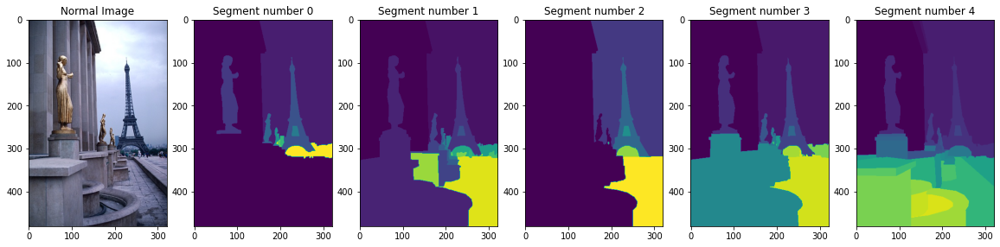

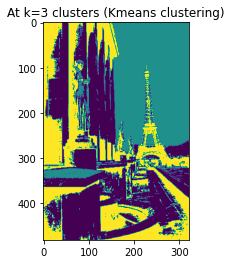

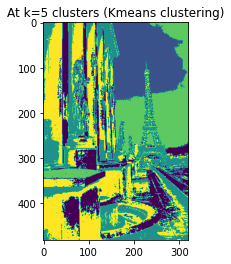

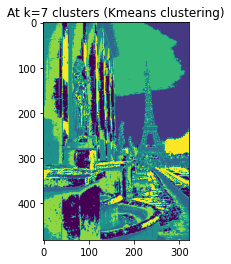

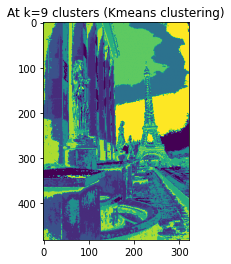

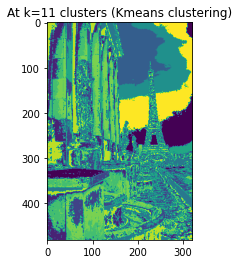

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.13541077744382682
F-measure at k: 3  and groundTruth segment: 1  is: 0.08762150153596582
F-measure at k: 3  and groundTruth segment: 2  is: 0.22016242988600188
F-measure at k: 3  and groundTruth segment: 3  is: 0.111417071441206
F-measure at k: 3  and groundTruth segment: 4  is: 0.10061620804050311
Average at K: 3  is:  0.13104559766950072
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.17131429485009872
F-measure at k: 5  and groundTruth segment: 1  is: 0.11085485824246373
F-measure at k: 5  and groundTruth segment: 2  is: 0.1989022465757314
F-measure at k: 5  and groundTruth segment: 3  is: 0.14334196865731935
F-measure at k: 5  and groundTruth segment: 4  is: 0.09904257200306174
Average at K: 5  is:  0.144691188065735
------------------------------------
F-measure at k: 7  and groundTruth segm

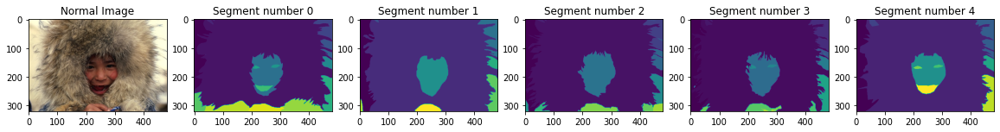

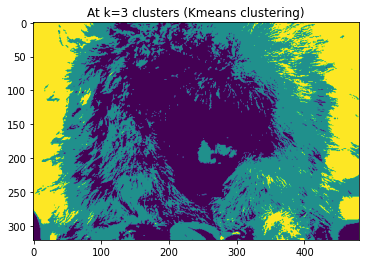

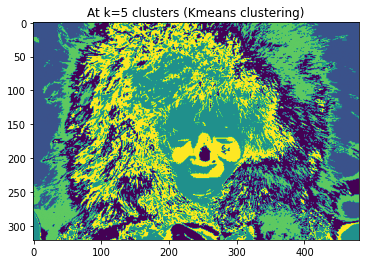

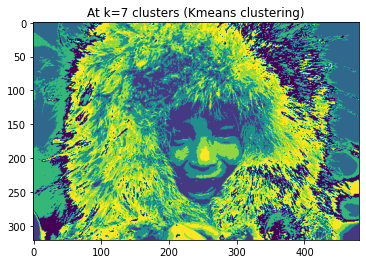

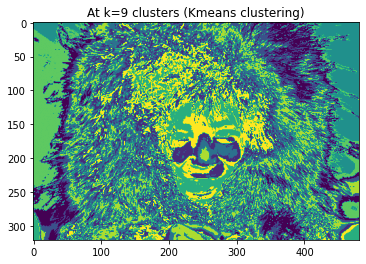

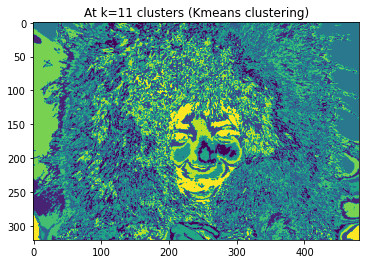

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.10208910855071433
F-measure at k: 3  and groundTruth segment: 1  is: 0.20768309922212733
F-measure at k: 3  and groundTruth segment: 2  is: 0.09741815410618258
F-measure at k: 3  and groundTruth segment: 3  is: 0.07036028203534764
F-measure at k: 3  and groundTruth segment: 4  is: 0.18196007724887156
Average at K: 3  is:  0.13190214423264868
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.178913755374435
F-measure at k: 5  and groundTruth segment: 1  is: 0.2885716232480432
F-measure at k: 5  and groundTruth segment: 2  is: 0.15442381678934355
F-measure at k: 5  and groundTruth segment: 3  is: 0.11034564572406728
F-measure at k: 5  and groundTruth segment: 4  is: 0.2644512653876255
Average at K: 5  is:  0.19934122130470291
------------------------------------
F-measure at k: 7  and groundTruth seg

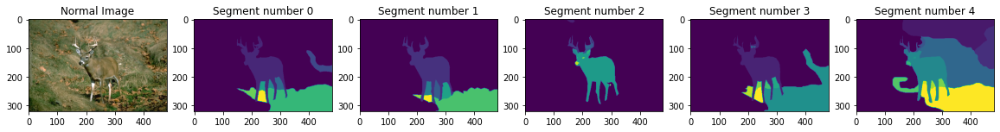

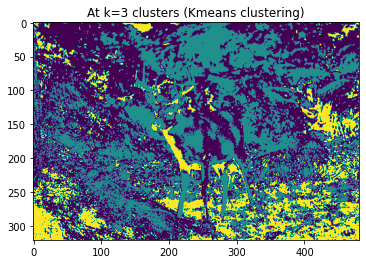

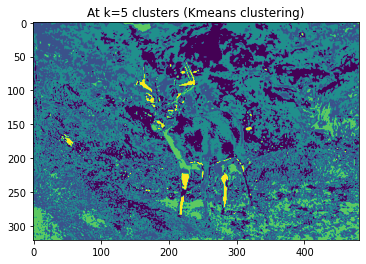

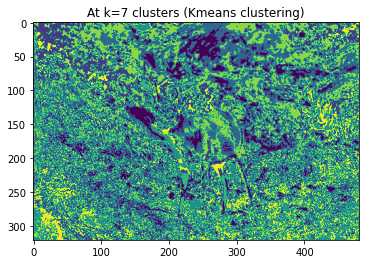

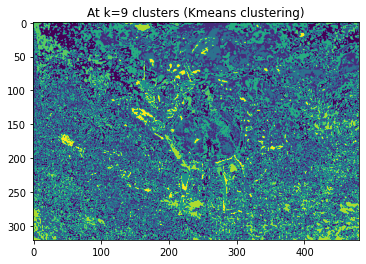

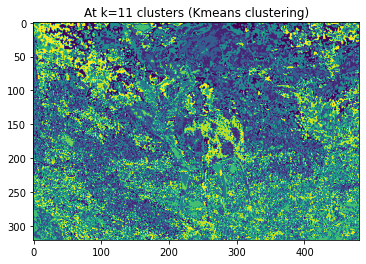

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.22503467419495649
F-measure at k: 3  and groundTruth segment: 1  is: 0.2666258466483296
F-measure at k: 3  and groundTruth segment: 2  is: 0.2919175627967691
F-measure at k: 3  and groundTruth segment: 3  is: 0.21012301772159991
F-measure at k: 3  and groundTruth segment: 4  is: 0.13935792641107997
Average at K: 3  is:  0.22661180555454702
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.26344769777911464
F-measure at k: 5  and groundTruth segment: 1  is: 0.2981598734859019
F-measure at k: 5  and groundTruth segment: 2  is: 0.217186554727877
F-measure at k: 5  and groundTruth segment: 3  is: 0.22448102194875155
F-measure at k: 5  and groundTruth segment: 4  is: 0.22406472611483194
Average at K: 5  is:  0.24546797481129543
------------------------------------
F-measure at k: 7  and groundTruth segm

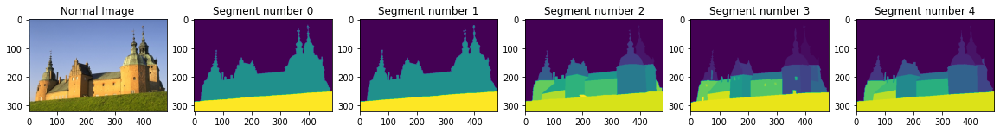

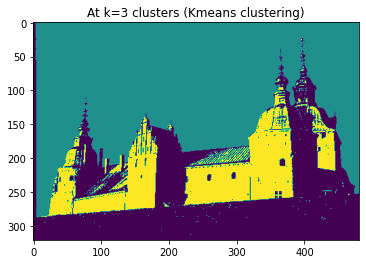

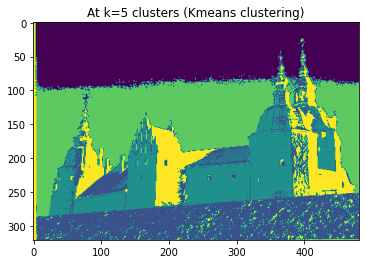

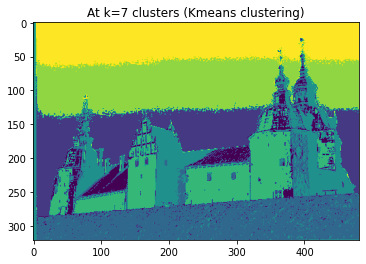

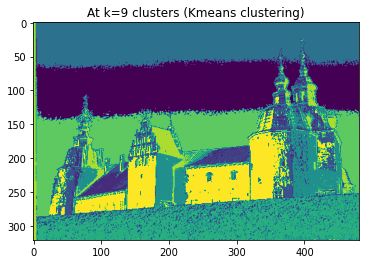

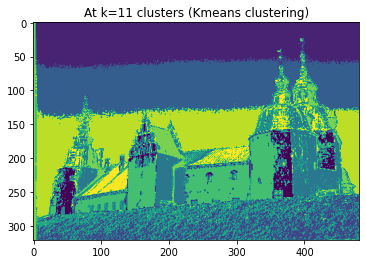

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.6803408157619625
F-measure at k: 3  and groundTruth segment: 1  is: 0.6792079150460868
F-measure at k: 3  and groundTruth segment: 2  is: 0.20319217190545524
F-measure at k: 3  and groundTruth segment: 3  is: 0.12708807761741647
F-measure at k: 3  and groundTruth segment: 4  is: 0.18719141757092803
Average at K: 3  is:  0.3754040795803698
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.28472664276273113
F-measure at k: 5  and groundTruth segment: 1  is: 0.2840840414202491
F-measure at k: 5  and groundTruth segment: 2  is: 0.1380314221003393
F-measure at k: 5  and groundTruth segment: 3  is: 0.0973508560388469
F-measure at k: 5  and groundTruth segment: 4  is: 0.14317263924980694
Average at K: 5  is:  0.1894731203143947
------------------------------------
F-measure at k: 7  and groundTruth segmen

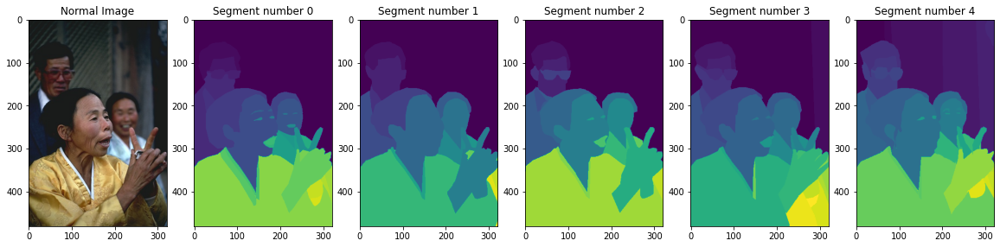

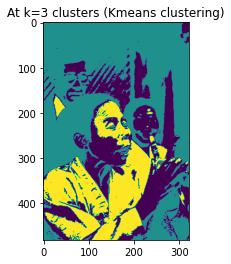

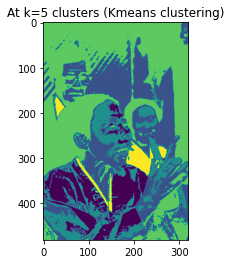

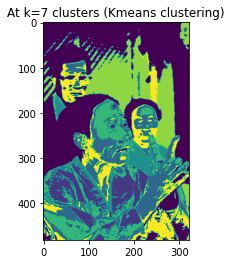

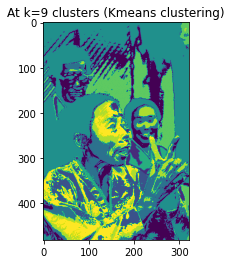

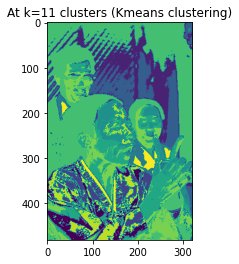

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.09427857508044478
F-measure at k: 3  and groundTruth segment: 1  is: 0.14297613309433094
F-measure at k: 3  and groundTruth segment: 2  is: 0.14298158611091746
F-measure at k: 3  and groundTruth segment: 3  is: 0.09749538675778954
F-measure at k: 3  and groundTruth segment: 4  is: 0.08276873302848023
Average at K: 3  is:  0.11210008281439258
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.08263335210426435
F-measure at k: 5  and groundTruth segment: 1  is: 0.1880246557610309
F-measure at k: 5  and groundTruth segment: 2  is: 0.1430449953500276
F-measure at k: 5  and groundTruth segment: 3  is: 0.13147278541688148
F-measure at k: 5  and groundTruth segment: 4  is: 0.07114064120579772
Average at K: 5  is:  0.12326328596760039
------------------------------------
F-measure at k: 7  and groundTruth s

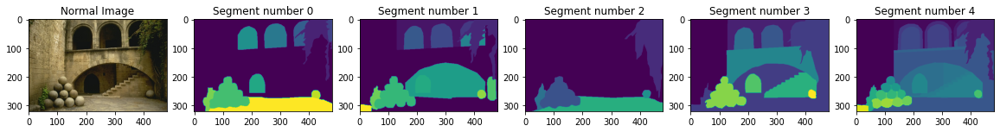

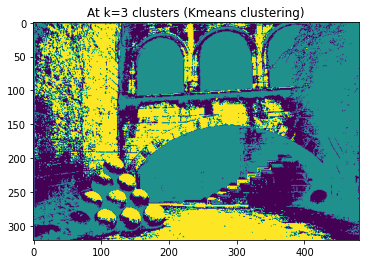

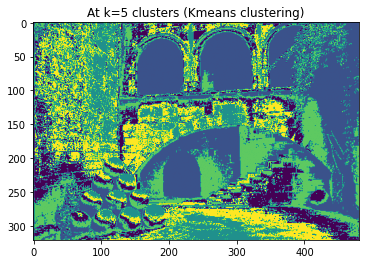

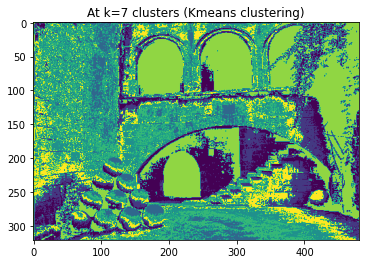

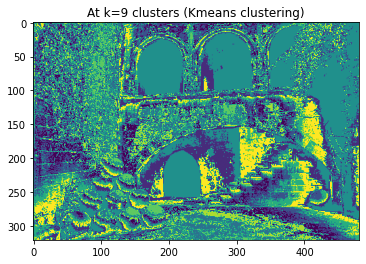

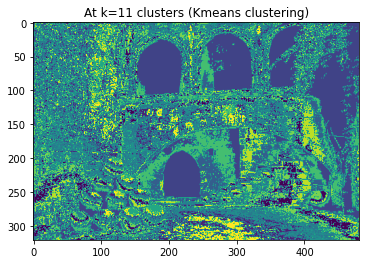

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.19849232904183306
F-measure at k: 3  and groundTruth segment: 1  is: 0.13702876619322998
F-measure at k: 3  and groundTruth segment: 2  is: 0.2386146899639515
F-measure at k: 3  and groundTruth segment: 3  is: 0.1837873313123018
F-measure at k: 3  and groundTruth segment: 4  is: 0.06361737544888342
Average at K: 3  is:  0.16430809839203994
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.174887995839473
F-measure at k: 5  and groundTruth segment: 1  is: 0.13621396148427517
F-measure at k: 5  and groundTruth segment: 2  is: 0.23939964028634597
F-measure at k: 5  and groundTruth segment: 3  is: 0.1802384555939366
F-measure at k: 5  and groundTruth segment: 4  is: 0.05829566564861324
Average at K: 5  is:  0.1578071437705288
------------------------------------
F-measure at k: 7  and groundTruth segme

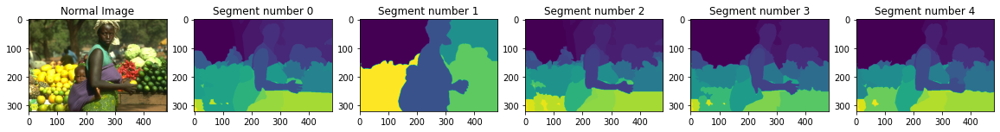

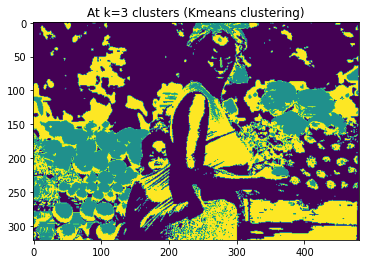

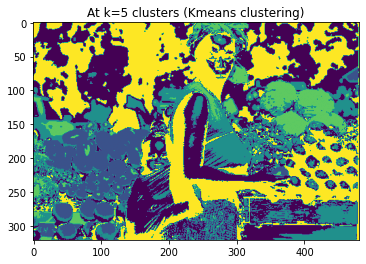

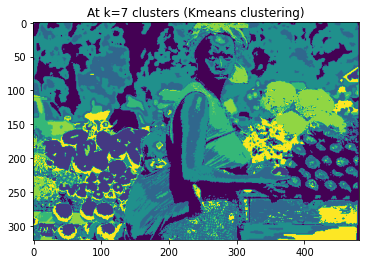

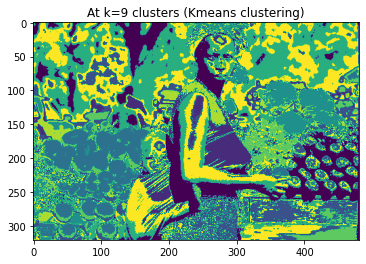

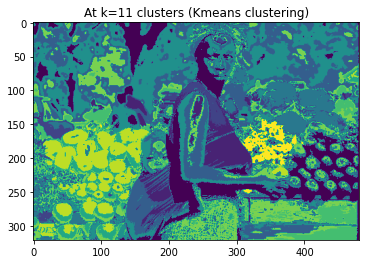

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.04181695957563065
F-measure at k: 3  and groundTruth segment: 1  is: 0.3309560906832766
F-measure at k: 3  and groundTruth segment: 2  is: 0.03271308436822822
F-measure at k: 3  and groundTruth segment: 3  is: 0.07701590887174536
F-measure at k: 3  and groundTruth segment: 4  is: 0.06982652467541933
Average at K: 3  is:  0.11046571363486005
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.06284461937346547
F-measure at k: 5  and groundTruth segment: 1  is: 0.25203738556410593
F-measure at k: 5  and groundTruth segment: 2  is: 0.048999066111289576
F-measure at k: 5  and groundTruth segment: 3  is: 0.11146926340850362
F-measure at k: 5  and groundTruth segment: 4  is: 0.09998252025972587
Average at K: 5  is:  0.11506657094341807
------------------------------------
F-measure at k: 7  and groundTruth

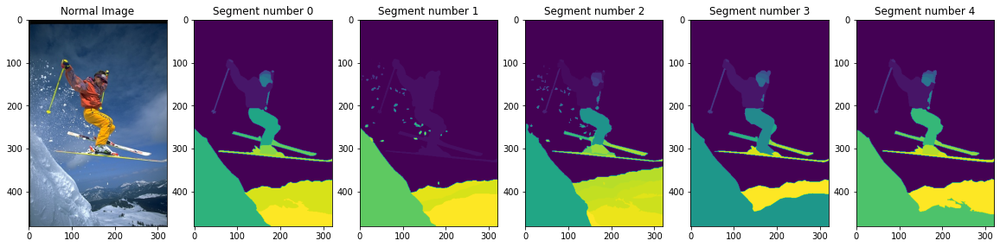

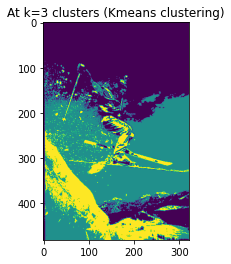

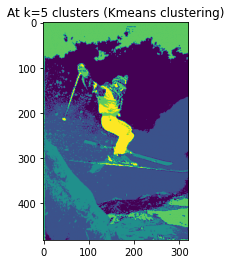

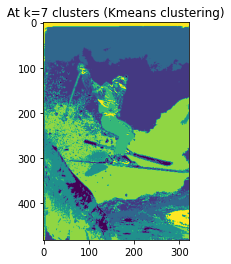

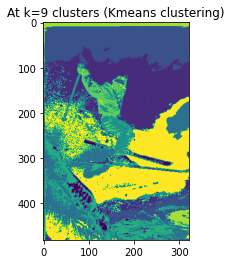

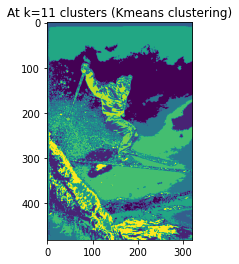

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.15042038496612767
F-measure at k: 3  and groundTruth segment: 1  is: 0.06907710814953814
F-measure at k: 3  and groundTruth segment: 2  is: 0.05189150066814776
F-measure at k: 3  and groundTruth segment: 3  is: 0.15140563609783003
F-measure at k: 3  and groundTruth segment: 4  is: 0.14393363262885625
Average at K: 3  is:  0.11334565250209996
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.1874478680211077
F-measure at k: 5  and groundTruth segment: 1  is: 0.07428534620719798
F-measure at k: 5  and groundTruth segment: 2  is: 0.07868542057200419
F-measure at k: 5  and groundTruth segment: 3  is: 0.19212958406235256
F-measure at k: 5  and groundTruth segment: 4  is: 0.18486037718395026
Average at K: 5  is:  0.1434817192093225
------------------------------------
F-measure at k: 7  and groundTruth s

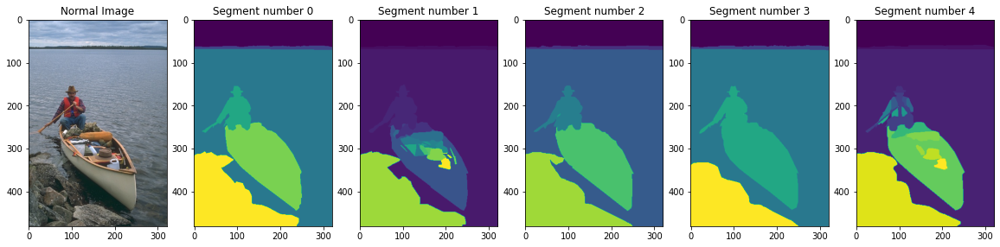

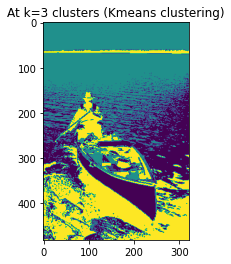

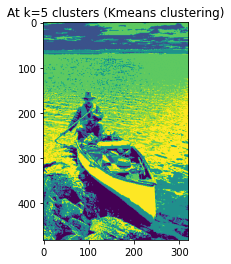

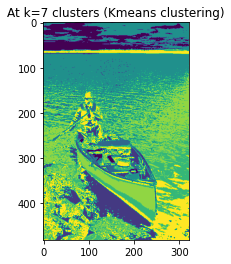

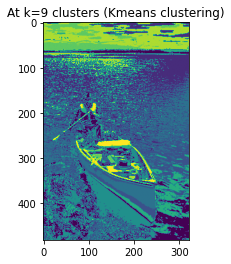

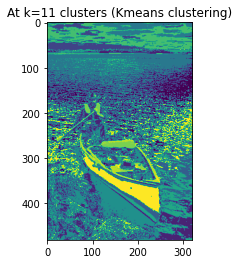

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.49117006527635926
F-measure at k: 3  and groundTruth segment: 1  is: 0.17398464013040352
F-measure at k: 3  and groundTruth segment: 2  is: 0.4309957909042352
F-measure at k: 3  and groundTruth segment: 3  is: 0.48595675039669434
F-measure at k: 3  and groundTruth segment: 4  is: 0.20940700160235062
Average at K: 3  is:  0.3583028496620086
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.4847014220040424
F-measure at k: 5  and groundTruth segment: 1  is: 0.19124680534801944
F-measure at k: 5  and groundTruth segment: 2  is: 0.44666992308525505
F-measure at k: 5  and groundTruth segment: 3  is: 0.5161190014011078
F-measure at k: 5  and groundTruth segment: 4  is: 0.22902355831659346
Average at K: 5  is:  0.3735521420310036
------------------------------------
F-measure at k: 7  and groundTruth segm

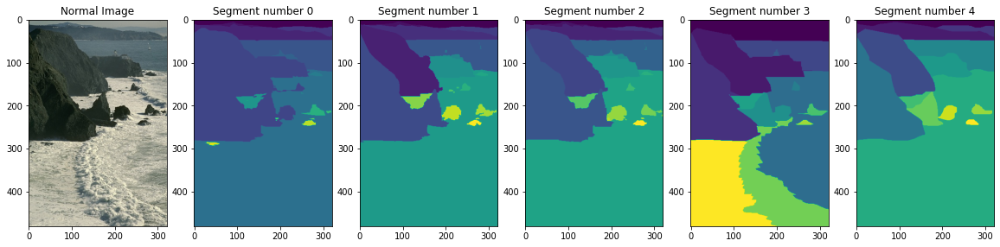

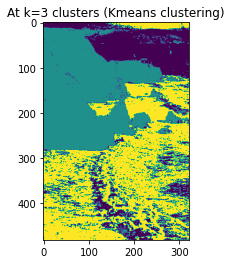

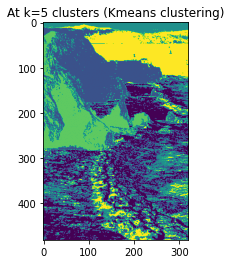

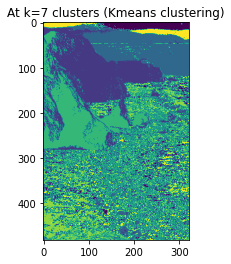

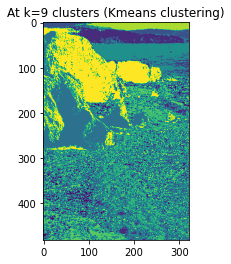

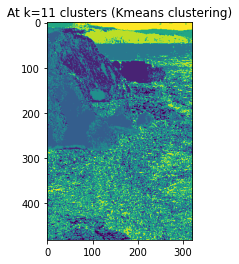

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.09067207145162133
F-measure at k: 3  and groundTruth segment: 1  is: 0.08041469271637122
F-measure at k: 3  and groundTruth segment: 2  is: 0.0921124321423406
F-measure at k: 3  and groundTruth segment: 3  is: 0.13431883091966074
F-measure at k: 3  and groundTruth segment: 4  is: 0.12426622263833077
Average at K: 3  is:  0.10435684997366494
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.12924359262646987
F-measure at k: 5  and groundTruth segment: 1  is: 0.14851575039166873
F-measure at k: 5  and groundTruth segment: 2  is: 0.14098308635244539
F-measure at k: 5  and groundTruth segment: 3  is: 0.2893911762775443
F-measure at k: 5  and groundTruth segment: 4  is: 0.12815694246821827
Average at K: 5  is:  0.1672581096232693
------------------------------------
F-measure at k: 7  and groundTruth se

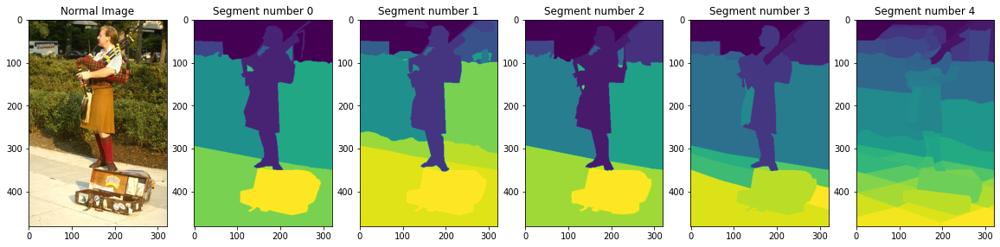

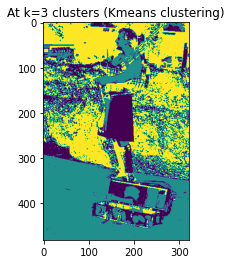

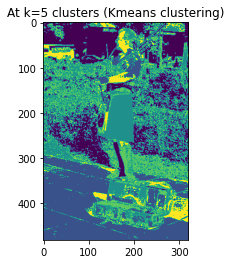

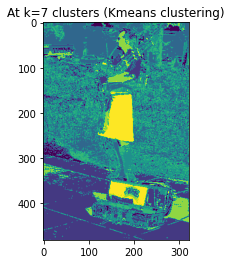

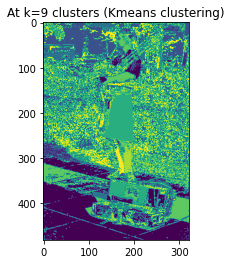

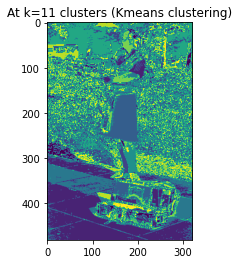

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.19264074728311642
F-measure at k: 3  and groundTruth segment: 1  is: 0.11471910611508918
F-measure at k: 3  and groundTruth segment: 2  is: 0.14755037261771653
F-measure at k: 3  and groundTruth segment: 3  is: 0.13184663013618927
F-measure at k: 3  and groundTruth segment: 4  is: 0.044100411160782275
Average at K: 3  is:  0.12617145346257871
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.21388349125185005
F-measure at k: 5  and groundTruth segment: 1  is: 0.11685295500875319
F-measure at k: 5  and groundTruth segment: 2  is: 0.22083985720789454
F-measure at k: 5  and groundTruth segment: 3  is: 0.1315990669543382
F-measure at k: 5  and groundTruth segment: 4  is: 0.05349559101125174
Average at K: 5  is:  0.14733419228681754
------------------------------------
F-measure at k: 7  and groundTruth

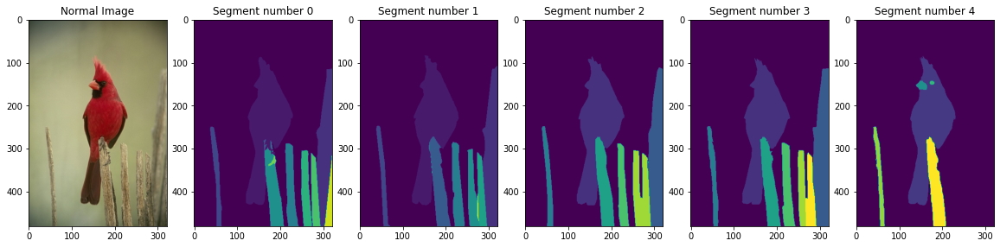

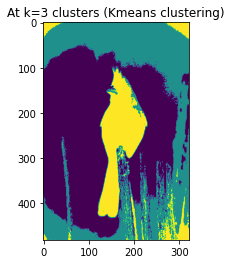

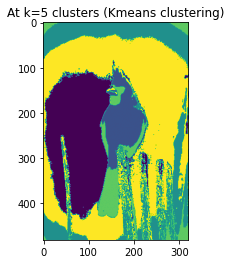

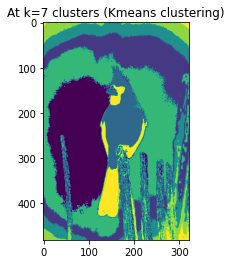

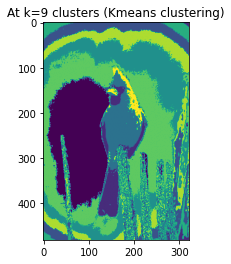

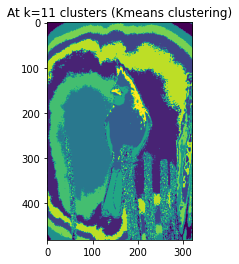

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.24132858887865902
F-measure at k: 3  and groundTruth segment: 1  is: 0.24128140441941578
F-measure at k: 3  and groundTruth segment: 2  is: 0.37948393540867925
F-measure at k: 3  and groundTruth segment: 3  is: 0.3813122390391542
F-measure at k: 3  and groundTruth segment: 4  is: 0.425049956211848
Average at K: 3  is:  0.3336912247915512
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.1685432453242693
F-measure at k: 5  and groundTruth segment: 1  is: 0.17235838270695947
F-measure at k: 5  and groundTruth segment: 2  is: 0.2546904227170925
F-measure at k: 5  and groundTruth segment: 3  is: 0.2527277505456819
F-measure at k: 5  and groundTruth segment: 4  is: 0.23272732025952317
Average at K: 5  is:  0.21620942431070528
------------------------------------
F-measure at k: 7  and groundTruth segmen

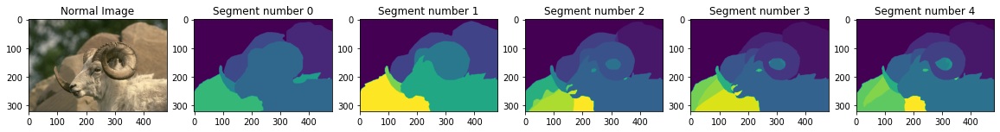

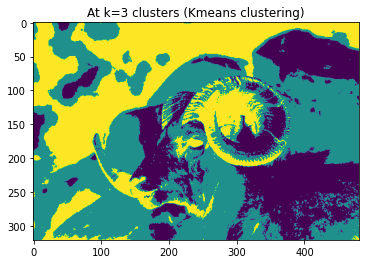

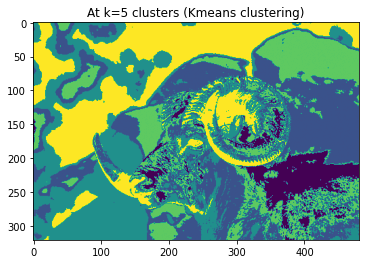

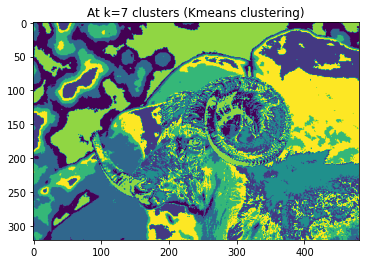

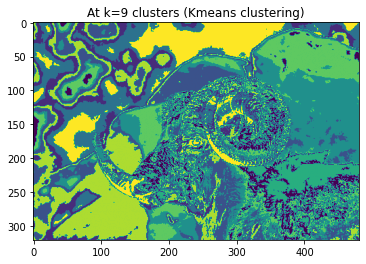

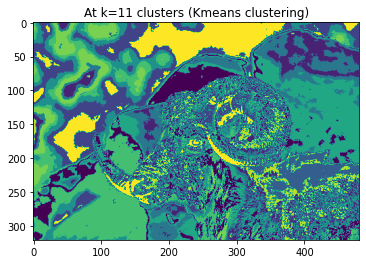

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.19845010326744736
F-measure at k: 3  and groundTruth segment: 1  is: 0.2774141776866765
F-measure at k: 3  and groundTruth segment: 2  is: 0.12860831261816671
F-measure at k: 3  and groundTruth segment: 3  is: 0.11214690083098225
F-measure at k: 3  and groundTruth segment: 4  is: 0.1286514832140125
Average at K: 3  is:  0.16905419552345707
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.217832326427825
F-measure at k: 5  and groundTruth segment: 1  is: 0.2511396771553994
F-measure at k: 5  and groundTruth segment: 2  is: 0.11411056274084347
F-measure at k: 5  and groundTruth segment: 3  is: 0.1352858881669266
F-measure at k: 5  and groundTruth segment: 4  is: 0.15480905434103584
Average at K: 5  is:  0.17463550176640608
------------------------------------
F-measure at k: 7  and groundTruth segme

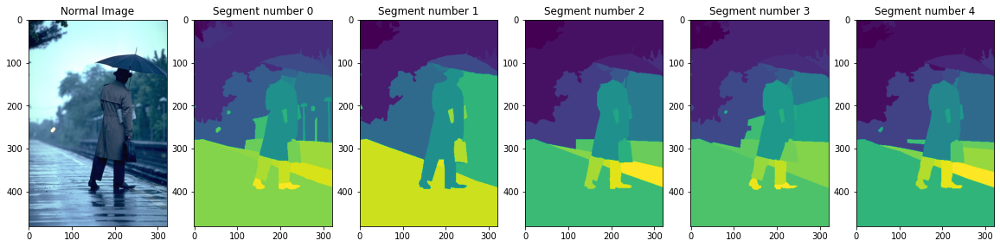

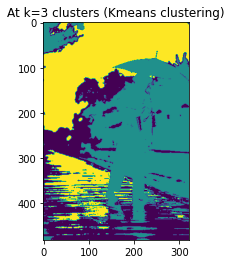

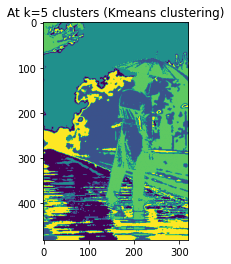

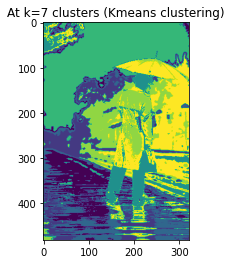

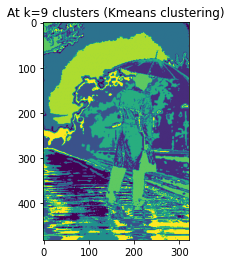

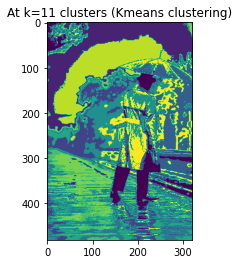

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.076492675398594
F-measure at k: 3  and groundTruth segment: 1  is: 0.1713901159191818
F-measure at k: 3  and groundTruth segment: 2  is: 0.19560493751492813
F-measure at k: 3  and groundTruth segment: 3  is: 0.12584842960626486
F-measure at k: 3  and groundTruth segment: 4  is: 0.1784630814522278
Average at K: 3  is:  0.14955984797823932
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.07834288003256369
F-measure at k: 5  and groundTruth segment: 1  is: 0.15113993266015388
F-measure at k: 5  and groundTruth segment: 2  is: 0.21862808229196762
F-measure at k: 5  and groundTruth segment: 3  is: 0.13128367372019523
F-measure at k: 5  and groundTruth segment: 4  is: 0.1907471564479438
Average at K: 5  is:  0.15402834503056487
------------------------------------
F-measure at k: 7  and groundTruth segm

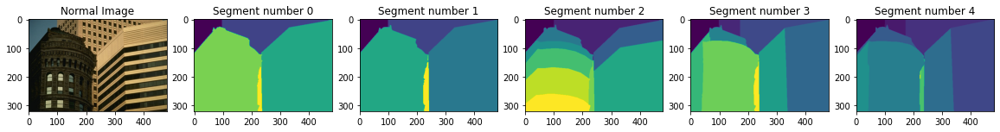

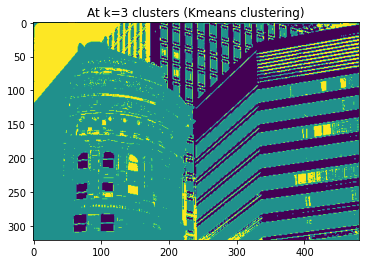

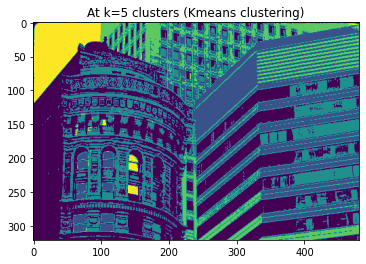

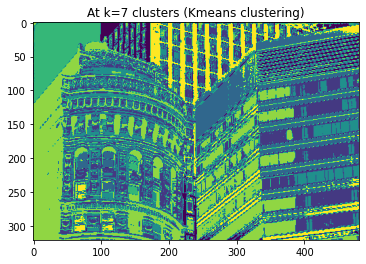

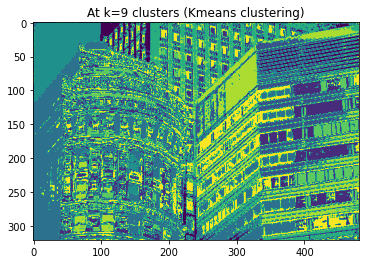

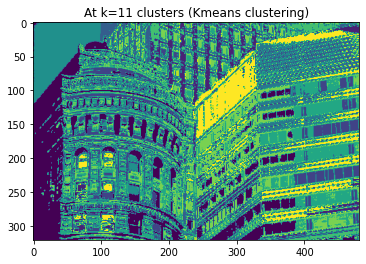

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.28706963579077505
F-measure at k: 3  and groundTruth segment: 1  is: 0.2866902886229215
F-measure at k: 3  and groundTruth segment: 2  is: 0.19176219965737787
F-measure at k: 3  and groundTruth segment: 3  is: 0.25664605893658415
F-measure at k: 3  and groundTruth segment: 4  is: 0.1885321443554103
Average at K: 3  is:  0.24214006547261374
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.21256335730345643
F-measure at k: 5  and groundTruth segment: 1  is: 0.25512807954795275
F-measure at k: 5  and groundTruth segment: 2  is: 0.16569596053696822
F-measure at k: 5  and groundTruth segment: 3  is: 0.2359990235324187
F-measure at k: 5  and groundTruth segment: 4  is: 0.17923831927003264
Average at K: 5  is:  0.20972494803816577
------------------------------------
F-measure at k: 7  and groundTruth se

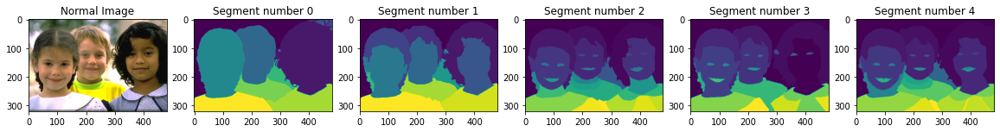

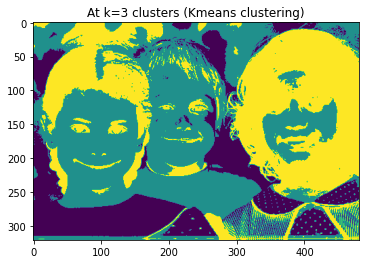

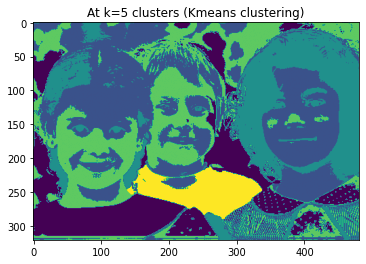

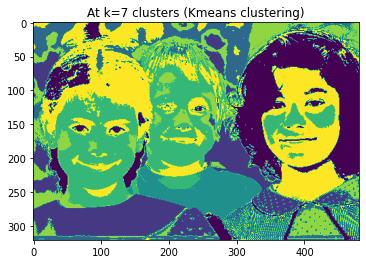

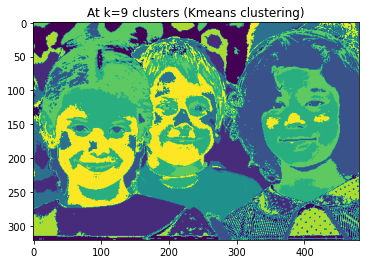

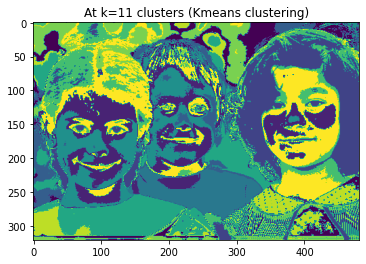

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.22872077381615202
F-measure at k: 3  and groundTruth segment: 1  is: 0.24487315441900165
F-measure at k: 3  and groundTruth segment: 2  is: 0.09974312342680082
F-measure at k: 3  and groundTruth segment: 3  is: 0.14886605573011946
F-measure at k: 3  and groundTruth segment: 4  is: 0.10113043077724078
Average at K: 3  is:  0.16466670763386296
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.24073787817636375
F-measure at k: 5  and groundTruth segment: 1  is: 0.254172505042303
F-measure at k: 5  and groundTruth segment: 2  is: 0.10564579816682135
F-measure at k: 5  and groundTruth segment: 3  is: 0.1724298877416644
F-measure at k: 5  and groundTruth segment: 4  is: 0.10702135945023239
Average at K: 5  is:  0.17600148571547697
------------------------------------
F-measure at k: 7  and groundTruth se

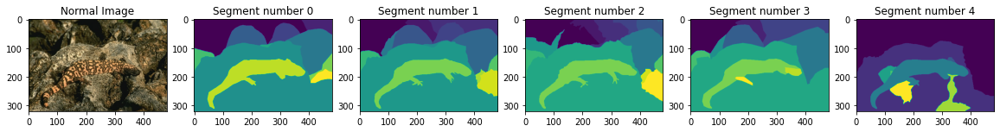

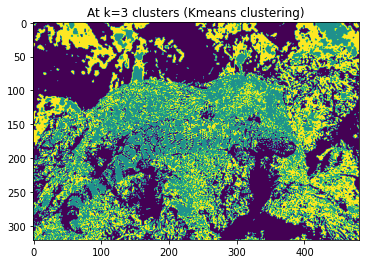

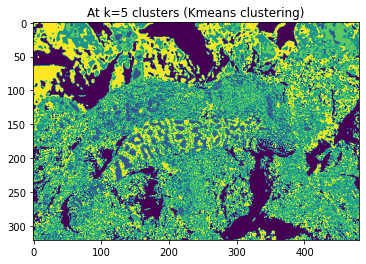

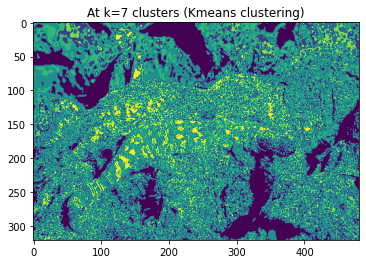

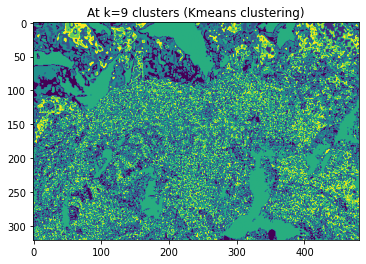

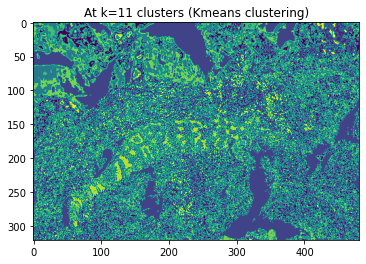

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.21627779751667034
F-measure at k: 3  and groundTruth segment: 1  is: 0.11470709218995985
F-measure at k: 3  and groundTruth segment: 2  is: 0.11753141996576666
F-measure at k: 3  and groundTruth segment: 3  is: 0.15572318056581752
F-measure at k: 3  and groundTruth segment: 4  is: 0.2719479433858349
Average at K: 3  is:  0.17523748672480988
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.2549122407100657
F-measure at k: 5  and groundTruth segment: 1  is: 0.16391889854083008
F-measure at k: 5  and groundTruth segment: 2  is: 0.16029394954622364
F-measure at k: 5  and groundTruth segment: 3  is: 0.224945773839452
F-measure at k: 5  and groundTruth segment: 4  is: 0.28486042666478983
Average at K: 5  is:  0.21778625786027223
------------------------------------
F-measure at k: 7  and groundTruth seg

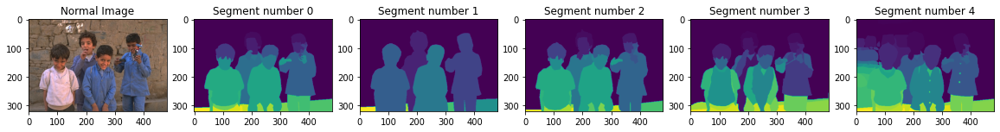

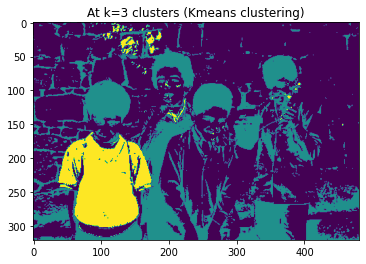

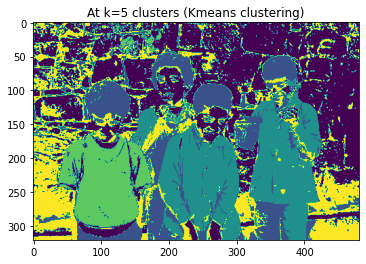

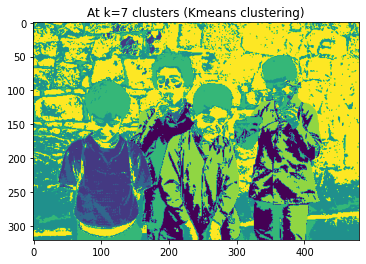

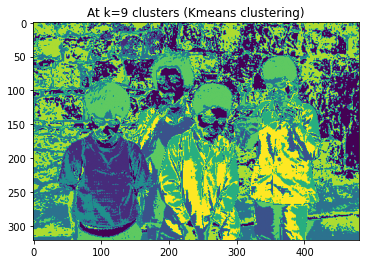

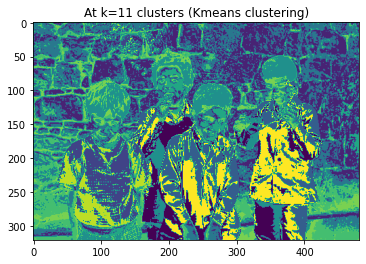

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.057321430769755294
F-measure at k: 3  and groundTruth segment: 1  is: 0.1705951681758856
F-measure at k: 3  and groundTruth segment: 2  is: 0.06554063076585309
F-measure at k: 3  and groundTruth segment: 3  is: 0.03724593784875274
F-measure at k: 3  and groundTruth segment: 4  is: 0.027267076235767202
Average at K: 3  is:  0.07159404875920279
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.06458264313962449
F-measure at k: 5  and groundTruth segment: 1  is: 0.18029384232522747
F-measure at k: 5  and groundTruth segment: 2  is: 0.07488279591973293
F-measure at k: 5  and groundTruth segment: 3  is: 0.042415072810878814
F-measure at k: 5  and groundTruth segment: 4  is: 0.028386422696429707
Average at K: 5  is:  0.07811215537837868
------------------------------------
F-measure at k: 7  and groundTr

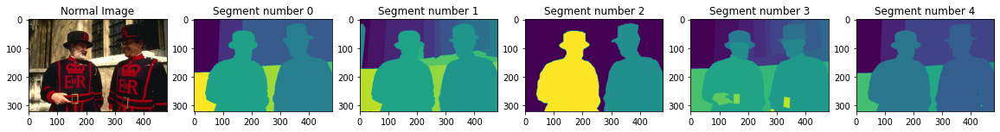

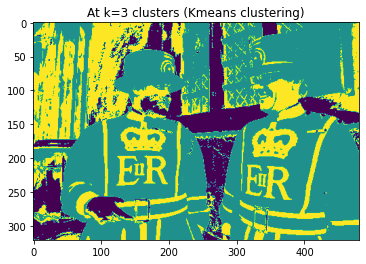

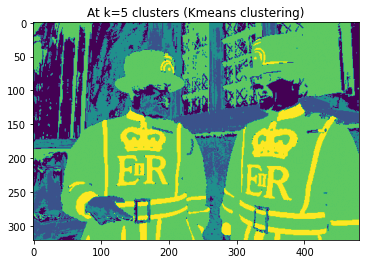

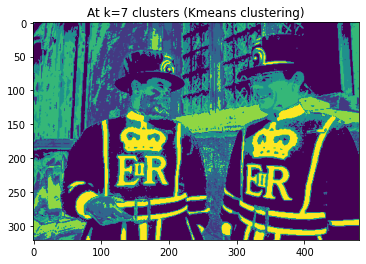

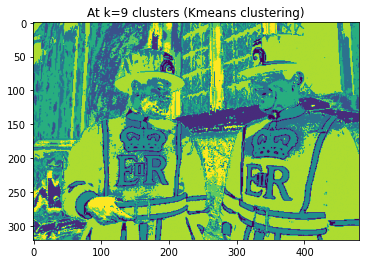

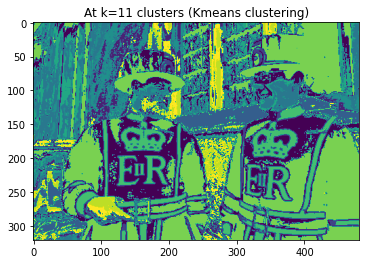

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.35973667680757465
F-measure at k: 3  and groundTruth segment: 1  is: 0.15026539346589976
F-measure at k: 3  and groundTruth segment: 2  is: 0.3921133596484967
F-measure at k: 3  and groundTruth segment: 3  is: 0.1567159164435861
F-measure at k: 3  and groundTruth segment: 4  is: 0.2957455416167759
Average at K: 3  is:  0.27091537759646667
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.35274584985053786
F-measure at k: 5  and groundTruth segment: 1  is: 0.09305278980544598
F-measure at k: 5  and groundTruth segment: 2  is: 0.34674743344065656
F-measure at k: 5  and groundTruth segment: 3  is: 0.1159315697354946
F-measure at k: 5  and groundTruth segment: 4  is: 0.2984516596927521
Average at K: 5  is:  0.2413858605049774
------------------------------------
F-measure at k: 7  and groundTruth segme

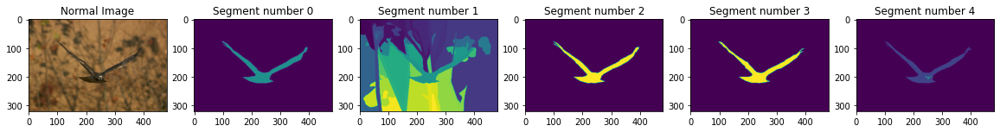

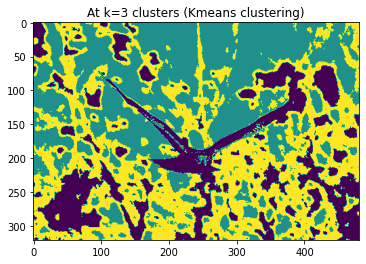

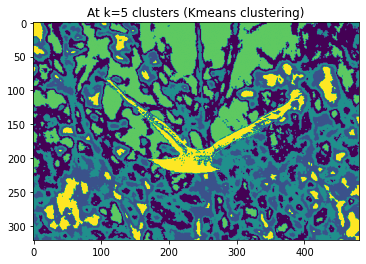

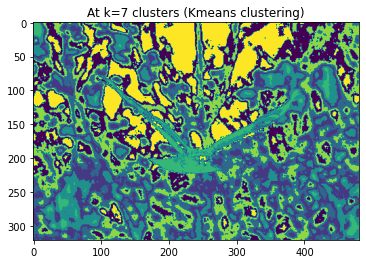

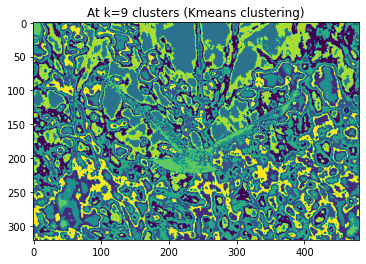

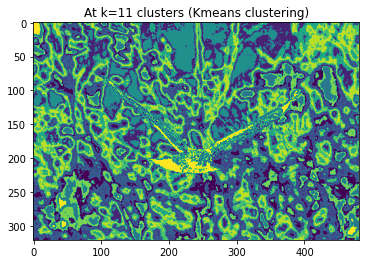

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.4305763580601602
F-measure at k: 3  and groundTruth segment: 1  is: 0.04122965506826743
F-measure at k: 3  and groundTruth segment: 2  is: 0.40060490715767777
F-measure at k: 3  and groundTruth segment: 3  is: 0.40028646541646906
F-measure at k: 3  and groundTruth segment: 4  is: 0.32852927365509715
Average at K: 3  is:  0.3202453318715343
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.2706909081937686
F-measure at k: 5  and groundTruth segment: 1  is: 0.04929785428304643
F-measure at k: 5  and groundTruth segment: 2  is: 0.29864315403102387
F-measure at k: 5  and groundTruth segment: 3  is: 0.2990785732348957
F-measure at k: 5  and groundTruth segment: 4  is: 0.35912741779321117
Average at K: 5  is:  0.25536758150718913
------------------------------------
F-measure at k: 7  and groundTruth seg

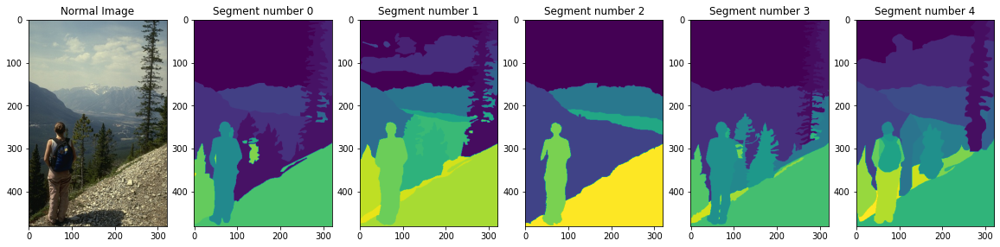

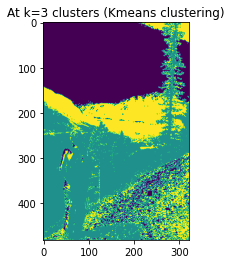

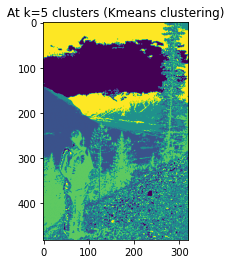

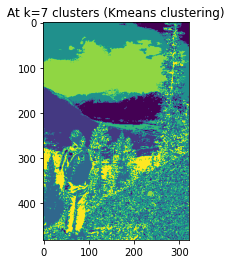

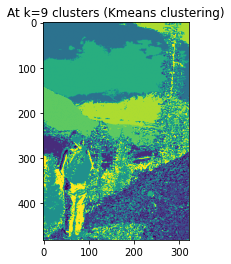

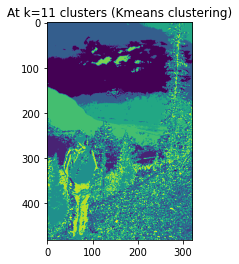

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.09551828173463164
F-measure at k: 3  and groundTruth segment: 1  is: 0.07244664641645099
F-measure at k: 3  and groundTruth segment: 2  is: 0.2698163538337735
F-measure at k: 3  and groundTruth segment: 3  is: 0.07679802843805637
F-measure at k: 3  and groundTruth segment: 4  is: 0.0893398065666206
Average at K: 3  is:  0.12078382339790661
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.09136276858339056
F-measure at k: 5  and groundTruth segment: 1  is: 0.07056531099806221
F-measure at k: 5  and groundTruth segment: 2  is: 0.2256659934247969
F-measure at k: 5  and groundTruth segment: 3  is: 0.12589989971305454
F-measure at k: 5  and groundTruth segment: 4  is: 0.08407946640304285
Average at K: 5  is:  0.11951468782446942
------------------------------------
F-measure at k: 7  and groundTruth se

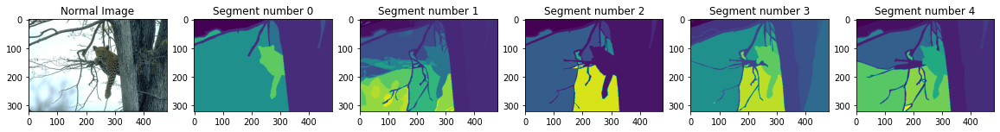

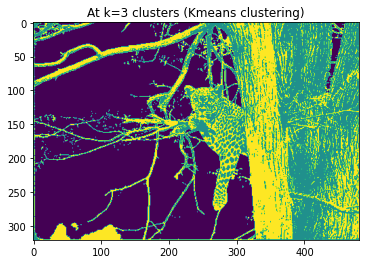

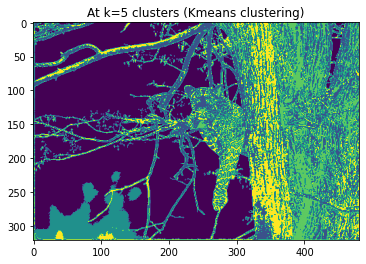

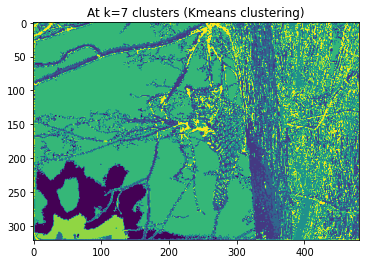

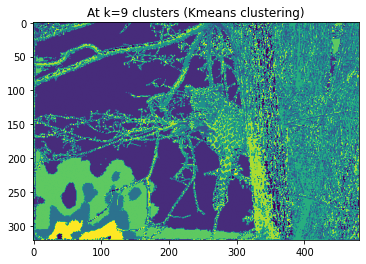

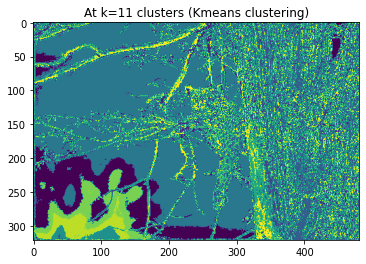

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.254468002838564
F-measure at k: 3  and groundTruth segment: 1  is: 0.0488275999625334
F-measure at k: 3  and groundTruth segment: 2  is: 0.14827959812158711
F-measure at k: 3  and groundTruth segment: 3  is: 0.13896905633038797
F-measure at k: 3  and groundTruth segment: 4  is: 0.10388997179240442
Average at K: 3  is:  0.1388868458090954
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.20031825598999675
F-measure at k: 5  and groundTruth segment: 1  is: 0.045816959775439384
F-measure at k: 5  and groundTruth segment: 2  is: 0.12706007809427036
F-measure at k: 5  and groundTruth segment: 3  is: 0.14146968951087
F-measure at k: 5  and groundTruth segment: 4  is: 0.1205082670563007
Average at K: 5  is:  0.12703465008537546
------------------------------------
F-measure at k: 7  and groundTruth segmen

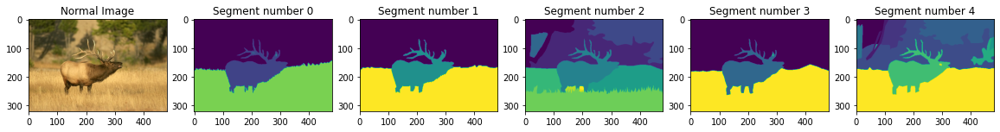

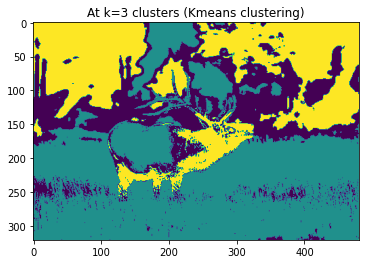

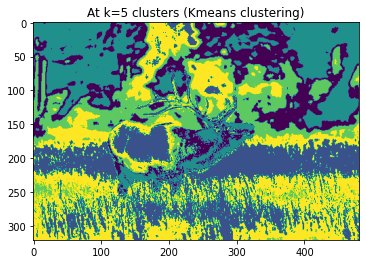

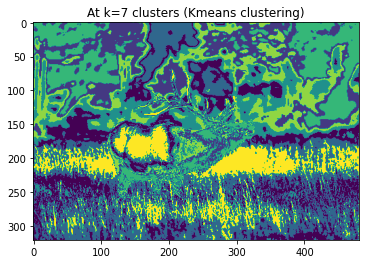

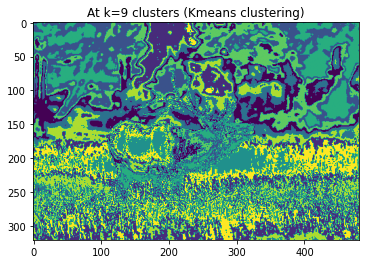

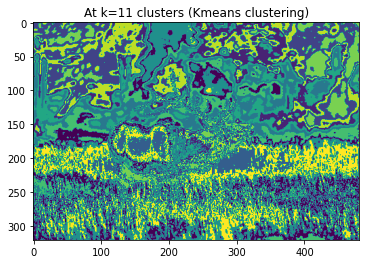

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.3177436508480523
F-measure at k: 3  and groundTruth segment: 1  is: 0.34406982180489337
F-measure at k: 3  and groundTruth segment: 2  is: 0.19599950306167166
F-measure at k: 3  and groundTruth segment: 3  is: 0.36430534568638523
F-measure at k: 3  and groundTruth segment: 4  is: 0.22709289214921471
Average at K: 3  is:  0.28984224271004344
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.28307161486282045
F-measure at k: 5  and groundTruth segment: 1  is: 0.09955407954588351
F-measure at k: 5  and groundTruth segment: 2  is: 0.18925053354546587
F-measure at k: 5  and groundTruth segment: 3  is: 0.25394091544683955
F-measure at k: 5  and groundTruth segment: 4  is: 0.24562787571217595
Average at K: 5  is:  0.21428900382263705
------------------------------------
F-measure at k: 7  and groundTruth 

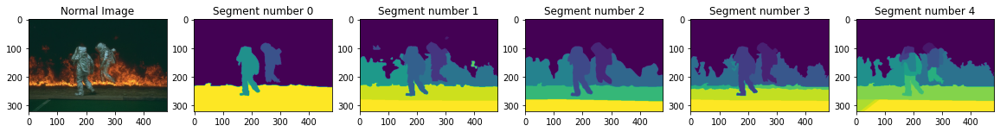

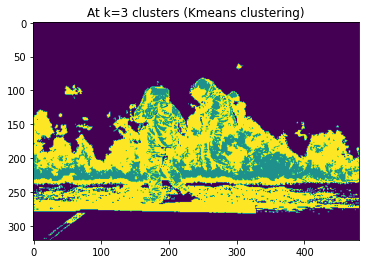

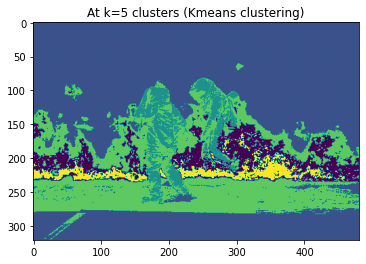

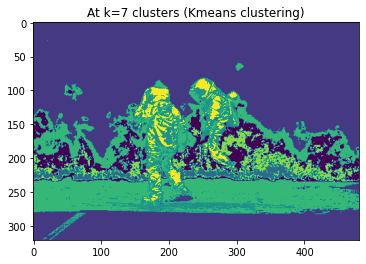

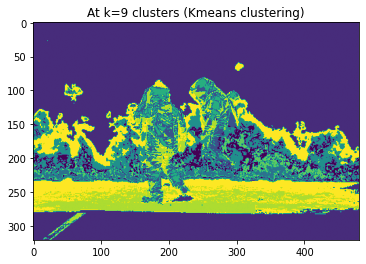

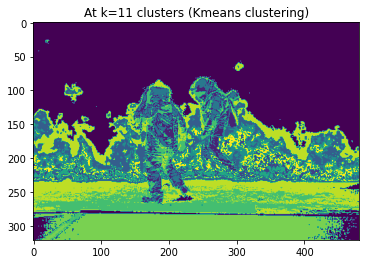

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.39535275180475915
F-measure at k: 3  and groundTruth segment: 1  is: 0.17215505025896607
F-measure at k: 3  and groundTruth segment: 2  is: 0.245567309564285
F-measure at k: 3  and groundTruth segment: 3  is: 0.21739607178254405
F-measure at k: 3  and groundTruth segment: 4  is: 0.15777788203336104
Average at K: 3  is:  0.23764981308878305
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.44378572457126164
F-measure at k: 5  and groundTruth segment: 1  is: 0.26171947607707446
F-measure at k: 5  and groundTruth segment: 2  is: 0.39704244816568796
F-measure at k: 5  and groundTruth segment: 3  is: 0.3582731626930707
F-measure at k: 5  and groundTruth segment: 4  is: 0.2579091800717423
Average at K: 5  is:  0.3437459983157674
------------------------------------
F-measure at k: 7  and groundTruth segm

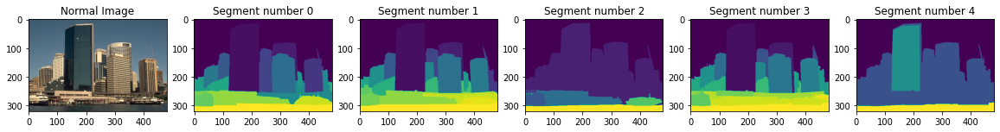

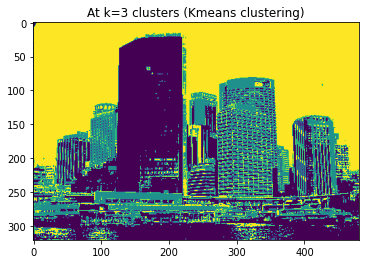

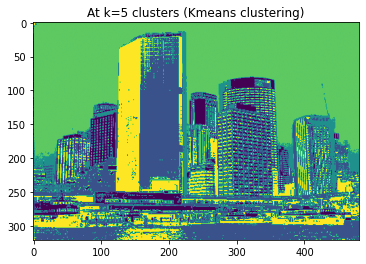

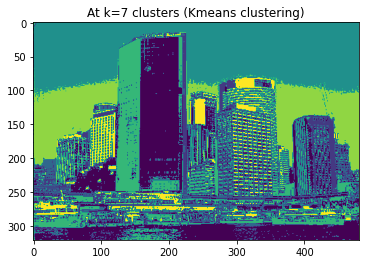

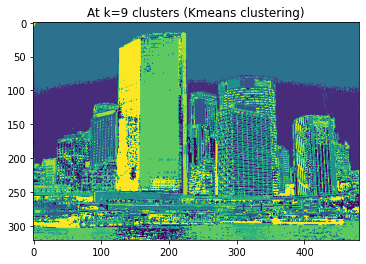

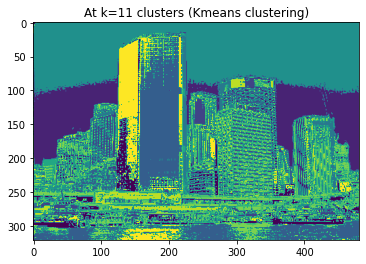

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.076552010807008
F-measure at k: 3  and groundTruth segment: 1  is: 0.07890578023751822
F-measure at k: 3  and groundTruth segment: 2  is: 0.16429748689556922
F-measure at k: 3  and groundTruth segment: 3  is: 0.06879040513118431
F-measure at k: 3  and groundTruth segment: 4  is: 0.2978644419920368
Average at K: 3  is:  0.13728202501266332
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.07807263337543141
F-measure at k: 5  and groundTruth segment: 1  is: 0.08092560521596016
F-measure at k: 5  and groundTruth segment: 2  is: 0.209240221559789
F-measure at k: 5  and groundTruth segment: 3  is: 0.07035180883486217
F-measure at k: 5  and groundTruth segment: 4  is: 0.2528631695067036
Average at K: 5  is:  0.13829068769854927
------------------------------------
F-measure at k: 7  and groundTruth segme

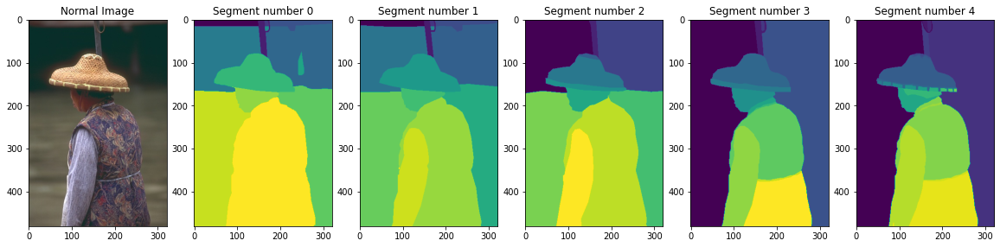

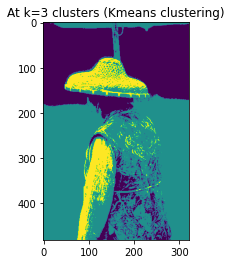

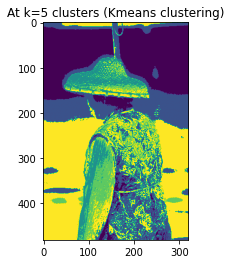

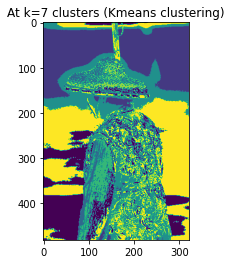

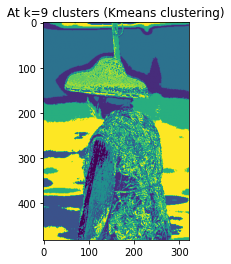

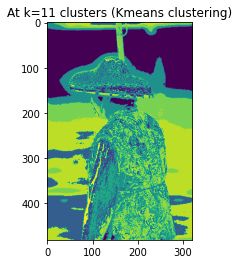

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.2116383147502032
F-measure at k: 3  and groundTruth segment: 1  is: 0.19919637841243124
F-measure at k: 3  and groundTruth segment: 2  is: 0.16356098860695248
F-measure at k: 3  and groundTruth segment: 3  is: 0.20159864519475443
F-measure at k: 3  and groundTruth segment: 4  is: 0.10509681799357112
Average at K: 3  is:  0.1762182289915825
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.218410083542398
F-measure at k: 5  and groundTruth segment: 1  is: 0.21010061506131505
F-measure at k: 5  and groundTruth segment: 2  is: 0.17426337595159047
F-measure at k: 5  and groundTruth segment: 3  is: 0.18517145600760274
F-measure at k: 5  and groundTruth segment: 4  is: 0.09694163175862569
Average at K: 5  is:  0.1769774324643064
------------------------------------
F-measure at k: 7  and groundTruth segm

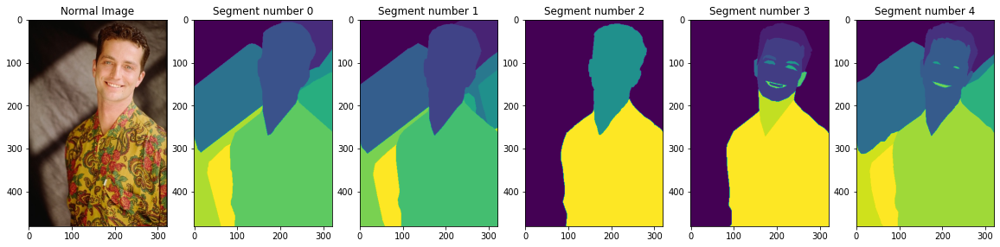

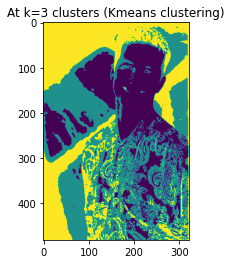

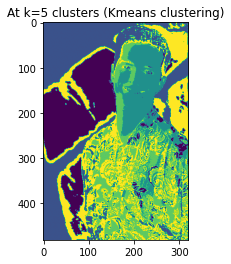

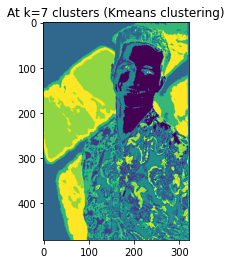

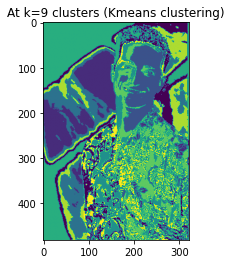

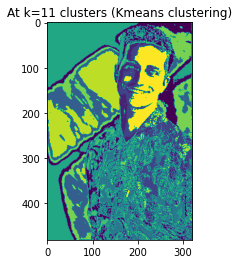

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.2406099369385113
F-measure at k: 3  and groundTruth segment: 1  is: 0.2051907798945687
F-measure at k: 3  and groundTruth segment: 2  is: 0.3905390677450725
F-measure at k: 3  and groundTruth segment: 3  is: 0.2775839971922075
F-measure at k: 3  and groundTruth segment: 4  is: 0.16072248676931716
Average at K: 3  is:  0.2549292537079354
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.3244918445768654
F-measure at k: 5  and groundTruth segment: 1  is: 0.29543463555527044
F-measure at k: 5  and groundTruth segment: 2  is: 0.5429080936386967
F-measure at k: 5  and groundTruth segment: 3  is: 0.25249292725036865
F-measure at k: 5  and groundTruth segment: 4  is: 0.21176986672997924
Average at K: 5  is:  0.3254194735502361
------------------------------------
F-measure at k: 7  and groundTruth segment

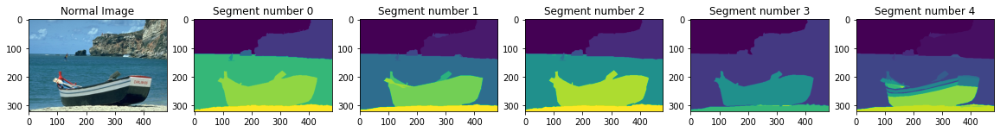

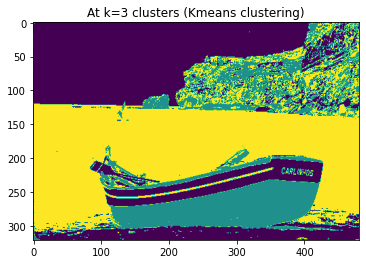

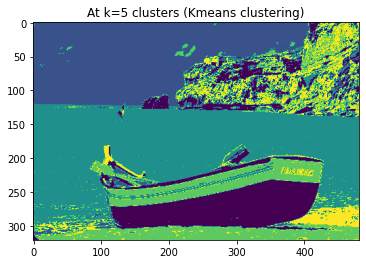

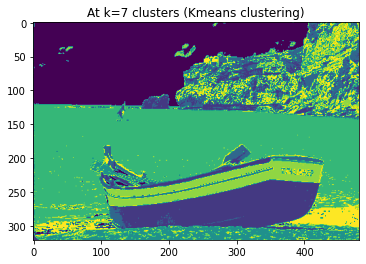

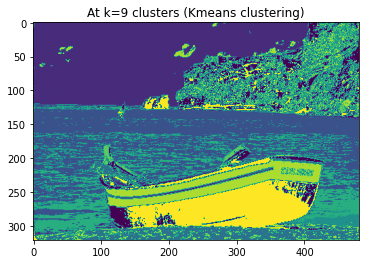

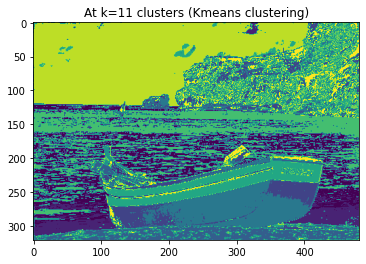

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.2815510450325629
F-measure at k: 3  and groundTruth segment: 1  is: 0.16237534882781818
F-measure at k: 3  and groundTruth segment: 2  is: 0.2400654990432565
F-measure at k: 3  and groundTruth segment: 3  is: 0.34454022670520873
F-measure at k: 3  and groundTruth segment: 4  is: 0.10433957201050306
Average at K: 3  is:  0.22657433832386992
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.3661486600578967
F-measure at k: 5  and groundTruth segment: 1  is: 0.23619342980081037
F-measure at k: 5  and groundTruth segment: 2  is: 0.3366158288656431
F-measure at k: 5  and groundTruth segment: 3  is: 0.4416154023203451
F-measure at k: 5  and groundTruth segment: 4  is: 0.15664466158563387
Average at K: 5  is:  0.30744359652606584
------------------------------------
F-measure at k: 7  and groundTruth segm

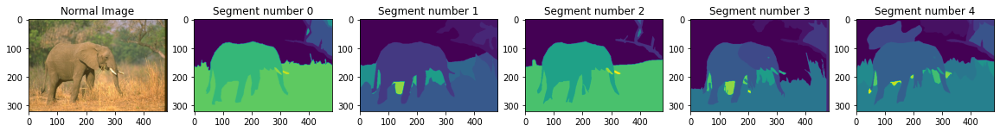

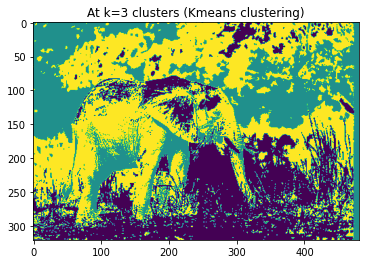

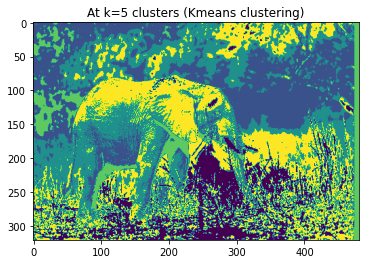

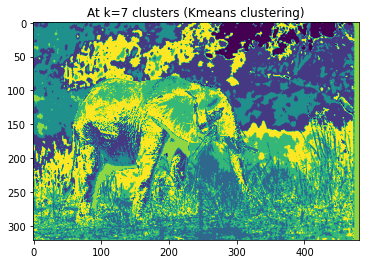

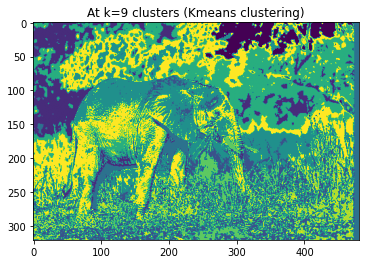

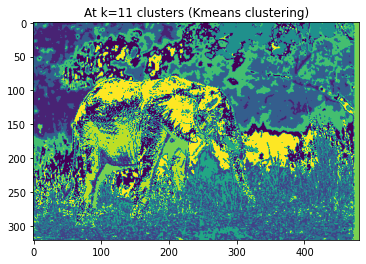

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.22920891464422774
F-measure at k: 3  and groundTruth segment: 1  is: 0.18167006422221524
F-measure at k: 3  and groundTruth segment: 2  is: 0.3247046282896938
F-measure at k: 3  and groundTruth segment: 3  is: 0.1858647371076906
F-measure at k: 3  and groundTruth segment: 4  is: 0.17834068605478548
Average at K: 3  is:  0.21995780606372256
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.21981759784583127
F-measure at k: 5  and groundTruth segment: 1  is: 0.19928835481823715
F-measure at k: 5  and groundTruth segment: 2  is: 0.2980648230177864
F-measure at k: 5  and groundTruth segment: 3  is: 0.24160951739900685
F-measure at k: 5  and groundTruth segment: 4  is: 0.19686425369674476
Average at K: 5  is:  0.23112890935552127
------------------------------------
F-measure at k: 7  and groundTruth se

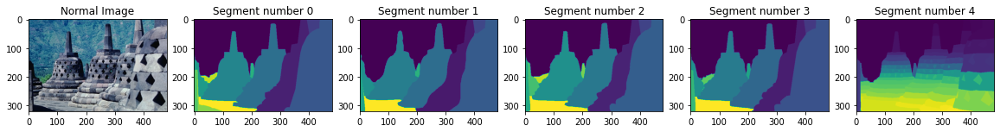

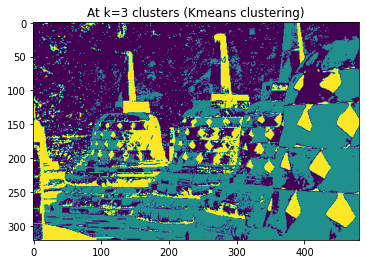

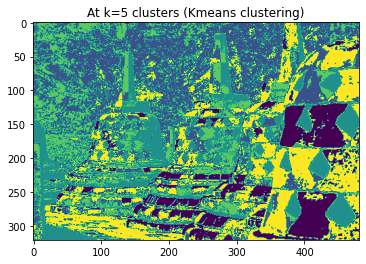

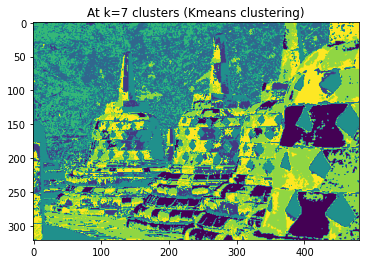

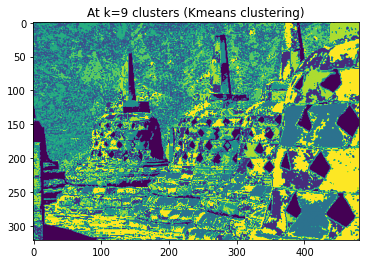

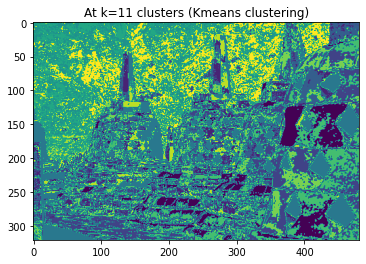

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.16267053101602405
F-measure at k: 3  and groundTruth segment: 1  is: 0.13552942686012548
F-measure at k: 3  and groundTruth segment: 2  is: 0.17598452715121915
F-measure at k: 3  and groundTruth segment: 3  is: 0.1538753487512599
F-measure at k: 3  and groundTruth segment: 4  is: 0.01982833078980191
Average at K: 3  is:  0.1295776329136861
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.26776040945736684
F-measure at k: 5  and groundTruth segment: 1  is: 0.2032495674384869
F-measure at k: 5  and groundTruth segment: 2  is: 0.28442183341699356
F-measure at k: 5  and groundTruth segment: 3  is: 0.2538471634043167
F-measure at k: 5  and groundTruth segment: 4  is: 0.03548934360245365
Average at K: 5  is:  0.20895366346392352
------------------------------------
F-measure at k: 7  and groundTruth seg

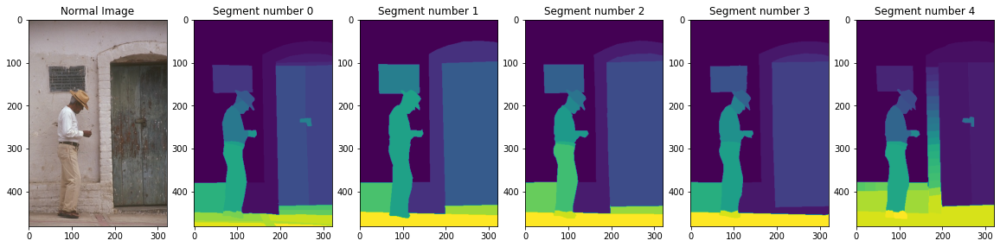

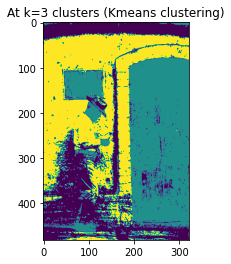

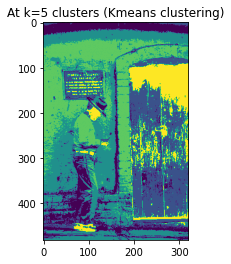

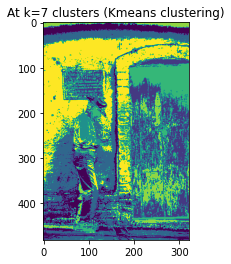

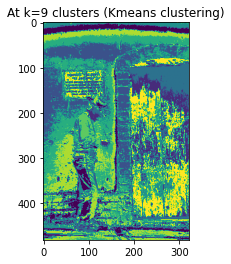

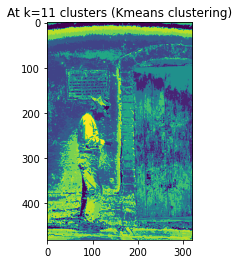

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.1185708289306387
F-measure at k: 3  and groundTruth segment: 1  is: 0.2885086926432625
F-measure at k: 3  and groundTruth segment: 2  is: 0.20376068585007628
F-measure at k: 3  and groundTruth segment: 3  is: 0.16663051564118864
F-measure at k: 3  and groundTruth segment: 4  is: 0.07582168510821971
Average at K: 3  is:  0.17065848163467717
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.1543284981962542
F-measure at k: 5  and groundTruth segment: 1  is: 0.24641364889977282
F-measure at k: 5  and groundTruth segment: 2  is: 0.1933524229454166
F-measure at k: 5  and groundTruth segment: 3  is: 0.16314937161857643
F-measure at k: 5  and groundTruth segment: 4  is: 0.07000847087411408
Average at K: 5  is:  0.16545048250682684
------------------------------------
F-measure at k: 7  and groundTruth seg

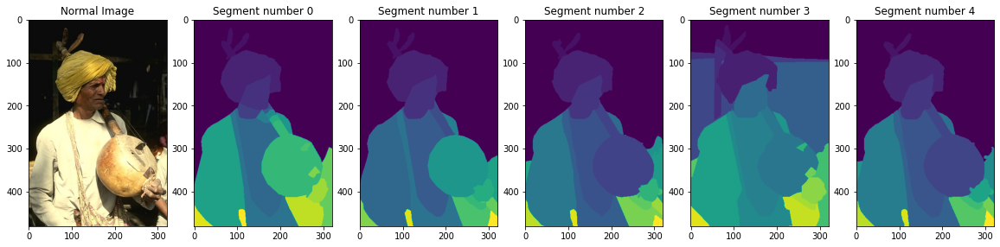

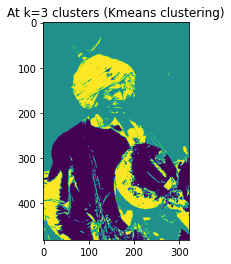

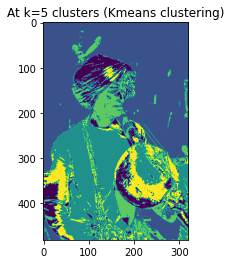

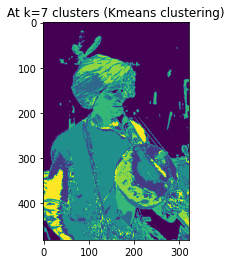

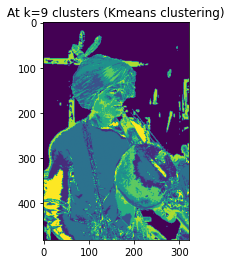

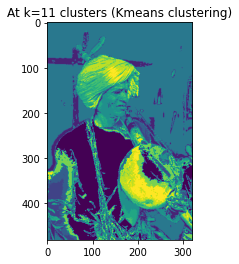

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.16786772236146047
F-measure at k: 3  and groundTruth segment: 1  is: 0.16771006521055803
F-measure at k: 3  and groundTruth segment: 2  is: 0.1789873419732083
F-measure at k: 3  and groundTruth segment: 3  is: 0.1510437583203832
F-measure at k: 3  and groundTruth segment: 4  is: 0.18635808261036435
Average at K: 3  is:  0.17039339409519488
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.17236066103823786
F-measure at k: 5  and groundTruth segment: 1  is: 0.17218383635911036
F-measure at k: 5  and groundTruth segment: 2  is: 0.18077127015078576
F-measure at k: 5  and groundTruth segment: 3  is: 0.16300955510957704
F-measure at k: 5  and groundTruth segment: 4  is: 0.18723000254511754
Average at K: 5  is:  0.1751110650405657
------------------------------------
F-measure at k: 7  and groundTruth se

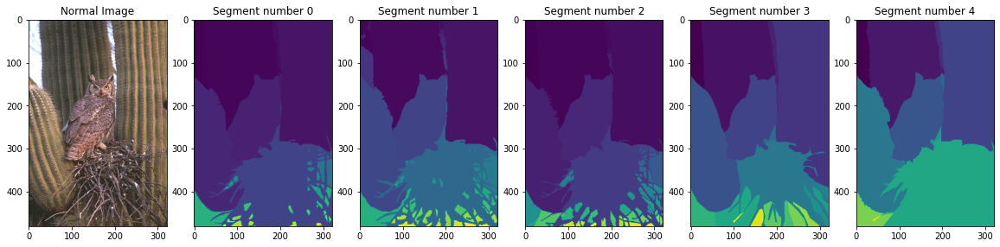

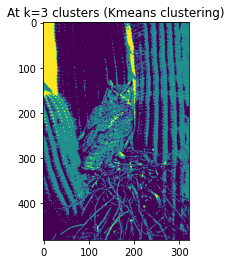

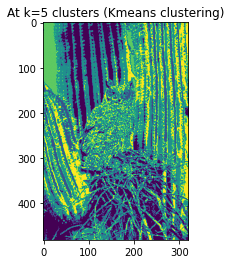

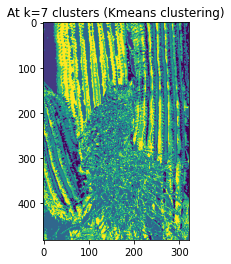

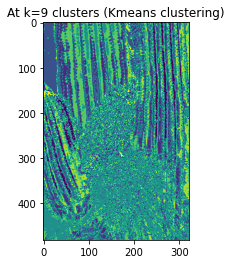

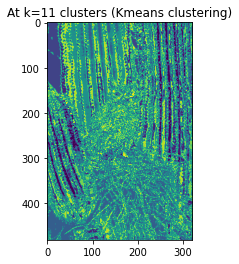

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.03486433520050678
F-measure at k: 3  and groundTruth segment: 1  is: 0.04980361987693214
F-measure at k: 3  and groundTruth segment: 2  is: 0.024695478828624617
F-measure at k: 3  and groundTruth segment: 3  is: 0.08840910464577649
F-measure at k: 3  and groundTruth segment: 4  is: 0.11104939436003096
Average at K: 3  is:  0.061764386582374195
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.08711127073197761
F-measure at k: 5  and groundTruth segment: 1  is: 0.028876924694552008
F-measure at k: 5  and groundTruth segment: 2  is: 0.06111919480288849
F-measure at k: 5  and groundTruth segment: 3  is: 0.20123733376443578
F-measure at k: 5  and groundTruth segment: 4  is: 0.2539783335469226
Average at K: 5  is:  0.1264646115081553
------------------------------------
F-measure at k: 7  and groundTrut

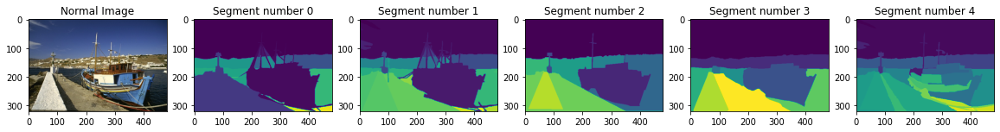

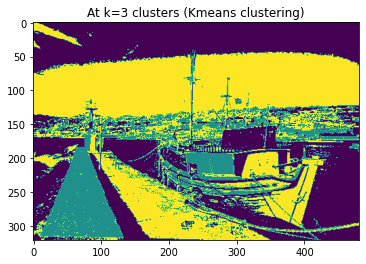

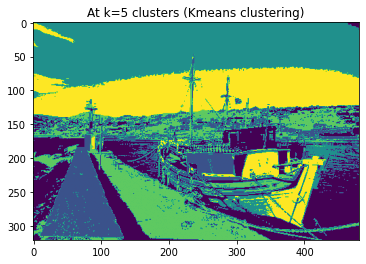

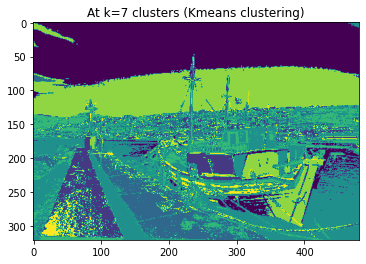

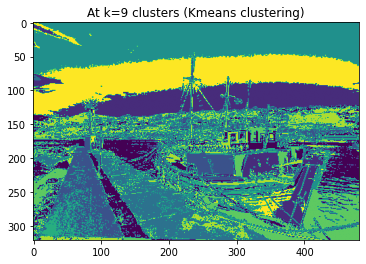

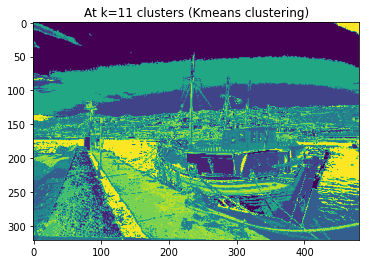

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.07000064351732699
F-measure at k: 3  and groundTruth segment: 1  is: 0.06904123237486084
F-measure at k: 3  and groundTruth segment: 2  is: 0.21335970140976743
F-measure at k: 3  and groundTruth segment: 3  is: 0.24401417021321353
F-measure at k: 3  and groundTruth segment: 4  is: 0.07271961914132964
Average at K: 3  is:  0.13382707333129967
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.10168522131451875
F-measure at k: 5  and groundTruth segment: 1  is: 0.07963434315490886
F-measure at k: 5  and groundTruth segment: 2  is: 0.205737458550828
F-measure at k: 5  and groundTruth segment: 3  is: 0.20906900985585694
F-measure at k: 5  and groundTruth segment: 4  is: 0.0808303656353835
Average at K: 5  is:  0.1353912797022992
------------------------------------
F-measure at k: 7  and groundTruth seg

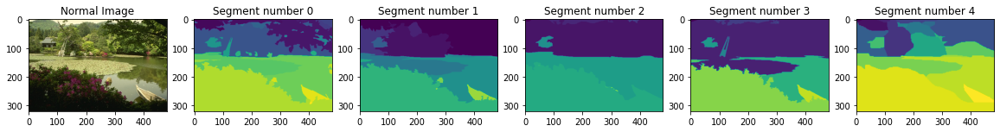

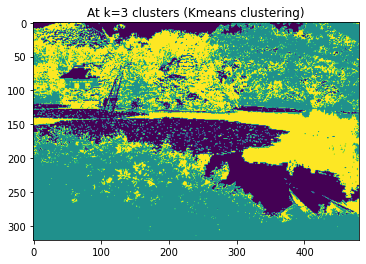

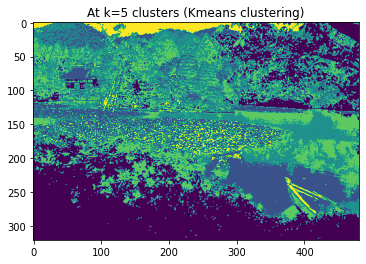

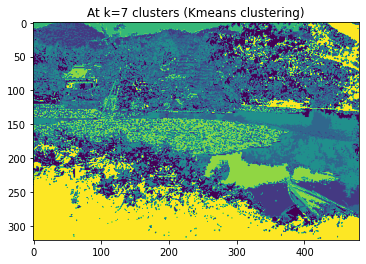

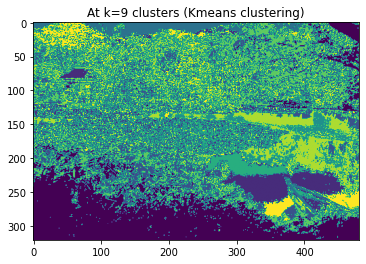

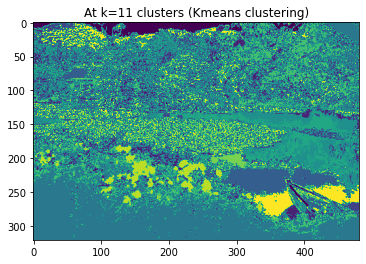

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.06010276779887565
F-measure at k: 3  and groundTruth segment: 1  is: 0.1747378743934912
F-measure at k: 3  and groundTruth segment: 2  is: 0.13669812145566046
F-measure at k: 3  and groundTruth segment: 3  is: 0.1918113081003162
F-measure at k: 3  and groundTruth segment: 4  is: 0.13762193339294077
Average at K: 3  is:  0.14019440102825684
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.06018510568507259
F-measure at k: 5  and groundTruth segment: 1  is: 0.16294438771192185
F-measure at k: 5  and groundTruth segment: 2  is: 0.19649063606019512
F-measure at k: 5  and groundTruth segment: 3  is: 0.264787294043181
F-measure at k: 5  and groundTruth segment: 4  is: 0.13969798116985185
Average at K: 5  is:  0.1648210809340445
------------------------------------
F-measure at k: 7  and groundTruth segm

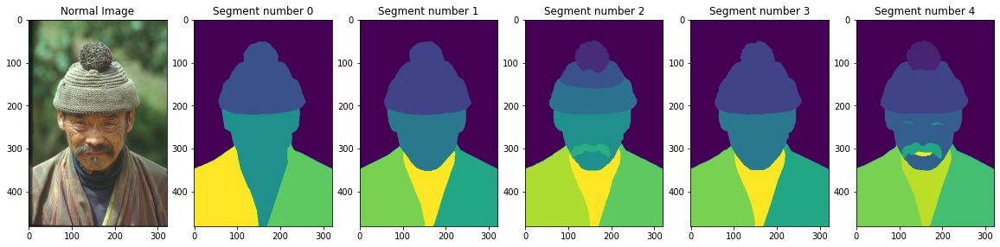

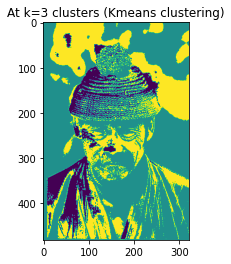

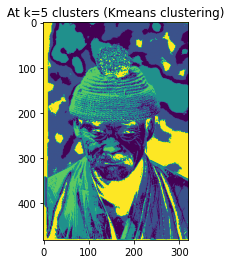

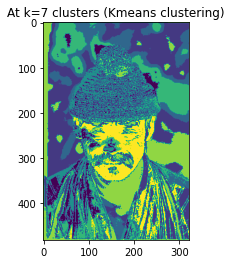

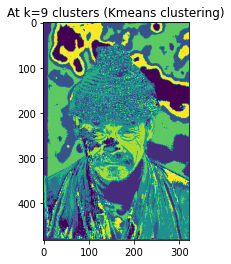

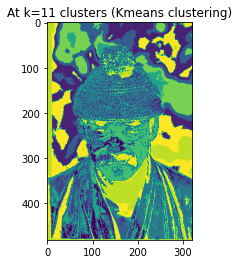

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.42959911976719284
F-measure at k: 3  and groundTruth segment: 1  is: 0.39787935183075335
F-measure at k: 3  and groundTruth segment: 2  is: 0.31470111717425997
F-measure at k: 3  and groundTruth segment: 3  is: 0.39800823931409435
F-measure at k: 3  and groundTruth segment: 4  is: 0.27470441545083124
Average at K: 3  is:  0.36297844870742635
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.30814974737606843
F-measure at k: 5  and groundTruth segment: 1  is: 0.3193329108896005
F-measure at k: 5  and groundTruth segment: 2  is: 0.3125239092955717
F-measure at k: 5  and groundTruth segment: 3  is: 0.3197488852492771
F-measure at k: 5  and groundTruth segment: 4  is: 0.2740836713892642
Average at K: 5  is:  0.3067678248399564
------------------------------------
F-measure at k: 7  and groundTruth segm

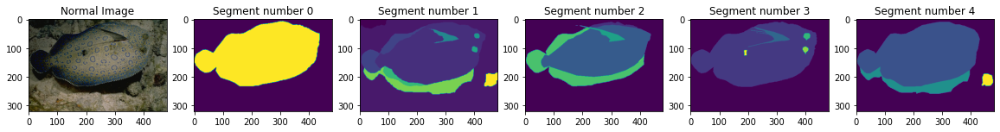

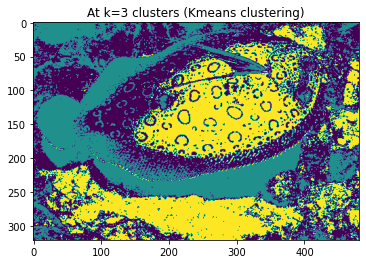

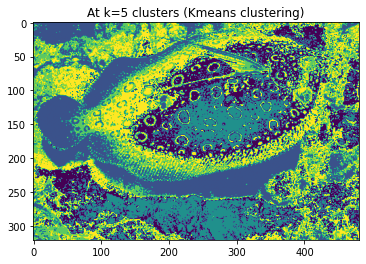

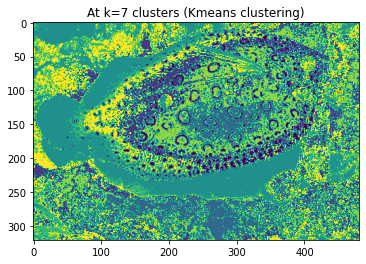

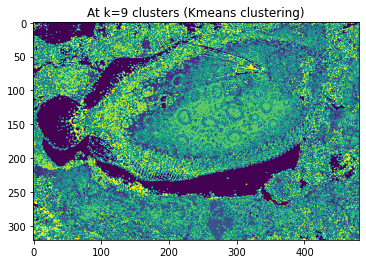

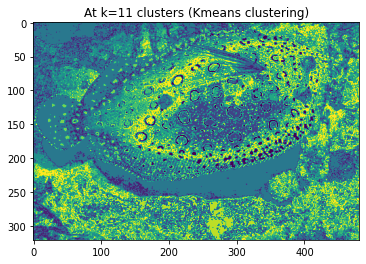

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.4379808010800205
F-measure at k: 3  and groundTruth segment: 1  is: 0.2375943795000868
F-measure at k: 3  and groundTruth segment: 2  is: 0.24498077210467248
F-measure at k: 3  and groundTruth segment: 3  is: 0.32503689574183847
F-measure at k: 3  and groundTruth segment: 4  is: 0.36593933694683634
Average at K: 3  is:  0.322306437074691
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.32404578562137637
F-measure at k: 5  and groundTruth segment: 1  is: 0.22803721816304448
F-measure at k: 5  and groundTruth segment: 2  is: 0.2862844119332281
F-measure at k: 5  and groundTruth segment: 3  is: 0.3022621138717964
F-measure at k: 5  and groundTruth segment: 4  is: 0.2522991053356925
Average at K: 5  is:  0.2785857269850276
------------------------------------
F-measure at k: 7  and groundTruth segment

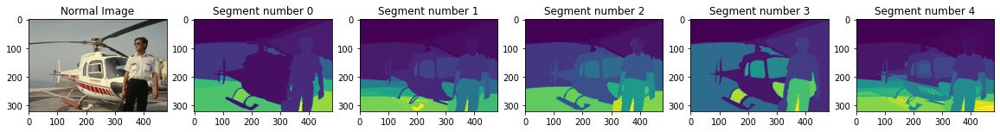

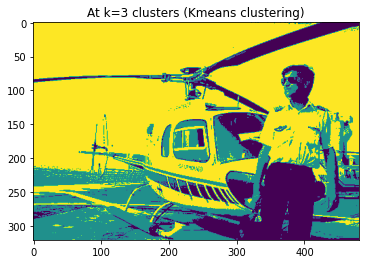

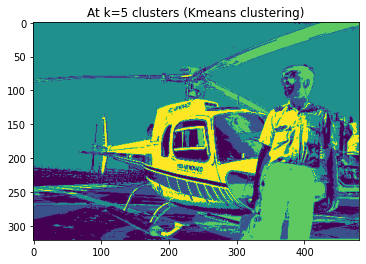

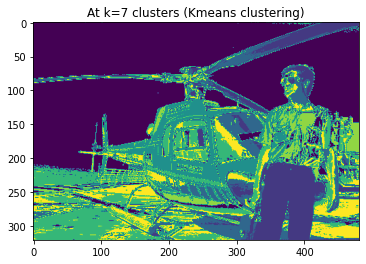

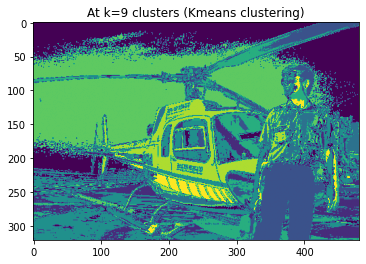

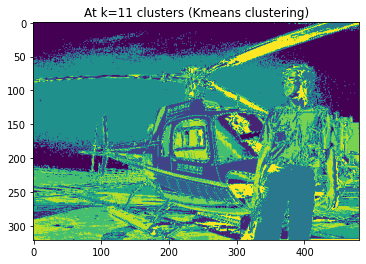

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.09844316814289213
F-measure at k: 3  and groundTruth segment: 1  is: 0.03870534355545978
F-measure at k: 3  and groundTruth segment: 2  is: 0.054337284850608424
F-measure at k: 3  and groundTruth segment: 3  is: 0.14337919971987215
F-measure at k: 3  and groundTruth segment: 4  is: 0.027076935034299813
Average at K: 3  is:  0.07238838626062646
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.0889260366156038
F-measure at k: 5  and groundTruth segment: 1  is: 0.038222629741116586
F-measure at k: 5  and groundTruth segment: 2  is: 0.053423298257286866
F-measure at k: 5  and groundTruth segment: 3  is: 0.13319718557428137
F-measure at k: 5  and groundTruth segment: 4  is: 0.026668254652641235
Average at K: 5  is:  0.06808748096818598
------------------------------------
F-measure at k: 7  and groundT

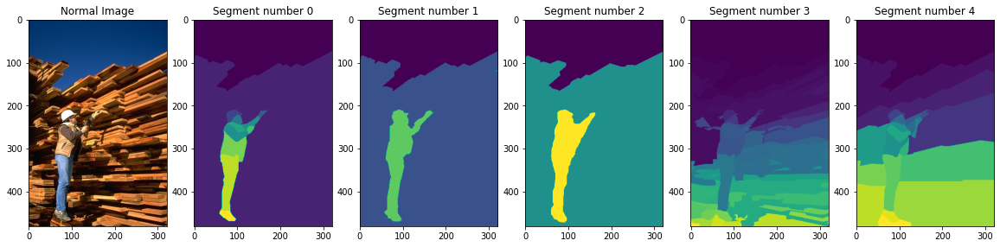

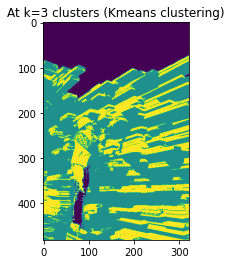

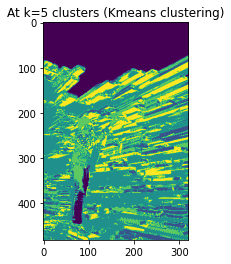

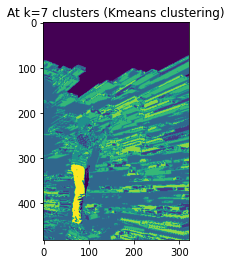

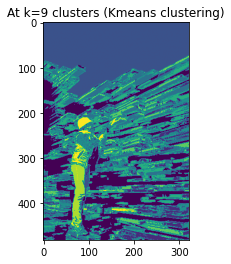

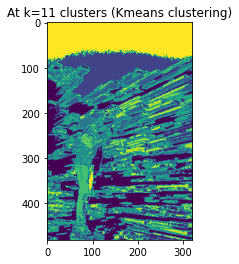

---------------Result Evaluation---------------
F - measure:
------------------------------------
F-measure at k: 3  and groundTruth segment: 0  is: 0.19302343164320224
F-measure at k: 3  and groundTruth segment: 1  is: 0.32628346521974155
F-measure at k: 3  and groundTruth segment: 2  is: 0.3849255165190804
F-measure at k: 3  and groundTruth segment: 3  is: 0.04128489675446281
F-measure at k: 3  and groundTruth segment: 4  is: 0.10245864865024726
Average at K: 3  is:  0.2095951917573468
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.3059454896094396
F-measure at k: 5  and groundTruth segment: 1  is: 0.29481201346823943
F-measure at k: 5  and groundTruth segment: 2  is: 0.33082667671857063
F-measure at k: 5  and groundTruth segment: 3  is: 0.05038084772276991
F-measure at k: 5  and groundTruth segment: 4  is: 0.15837973530755892
Average at K: 5  is:  0.22806895256531573
------------------------------------
F-measure at k: 7  and groundTruth se

In [ ]:
images=getImages(50)
k=[3,5,7,9,11]
for imageIdx,imageName in zip(range(len(images)),images):
  print('Image Number:',(imageIdx+1),' Image:',imageName)
  image,segments=displayImage(images[imageIdx])
  segImg=kmeans_clustering(image,k)
  print('---------------Result Evaluation---------------')
  print('F - measure:')
  print('------------------------------------')
  F_measure(segImg,segments,k,False)
  print('Condtional Entropy:')
  print('------------------------------------')
  ConditionalEntropy(segImg,segments,k,False)

#Segmentation using Normalized Cut

In [ ]:
def normalizedCut_clustering(image):
  
  image = cv2.resize(image,None,fx = 0.15,fy = 0.15)  
  dimensions = image.shape
  image = image.reshape((-1, 3))
  image = np.float32(image)

  segmentedImage=np.zeros((1,dimensions[0],dimensions[1]))
  clustering = SpectralClustering(n_clusters=5, affinity ='nearest_neighbors',n_neighbors=5,assign_labels='discretize',random_state=0).fit(image)
  segmentedImage[0] = np.array([j for j in clustering.labels_]).reshape(dimensions[0],dimensions[1])

  # show the image
  plt.title('At k=5 clusters (NC clustering)')
  plt.imshow(segmentedImage[0])
  plt.show()
  return segmentedImage

#Step 4 Results - Big picture

>



Image Number: 1  Image: 230098


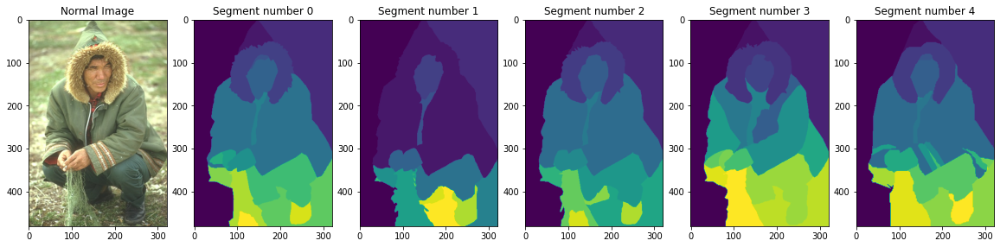

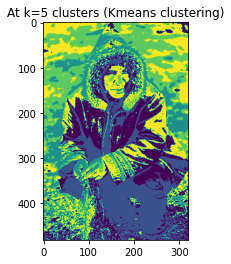

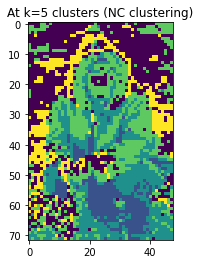

---------------Result Evaluation---------------
F - measure:
------------------------------------
At kmeans:
F-measure at k: 5  and groundTruth segment: 0  is: 0.20826006120496673
F-measure at k: 5  and groundTruth segment: 1  is: 0.1979385126203977
F-measure at k: 5  and groundTruth segment: 2  is: 0.19887072235949296
F-measure at k: 5  and groundTruth segment: 3  is: 0.17460447164075144
F-measure at k: 5  and groundTruth segment: 4  is: 0.15360012287782993
Average at K: 5  is:  0.18665477814068776
------------------------------------
Total Average is:  0.18665477814068776
------------------------------------
At normalized cut:
F-measure at k: 5  and groundTruth segment: 0  is: 0.14361659841337196
F-measure at k: 5  and groundTruth segment: 1  is: 0.15058768565086253
F-measure at k: 5  and groundTruth segment: 2  is: 0.14317749270125119
F-measure at k: 5  and groundTruth segment: 3  is: 0.12082808451401982
F-measure at k: 5  and groundTruth segment: 4  is: 0.09283966485229958
Average 

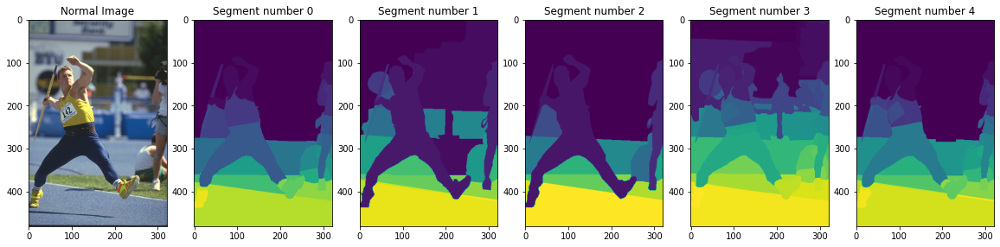

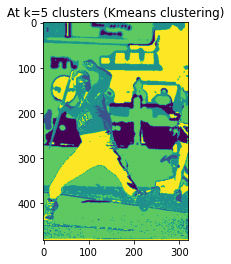

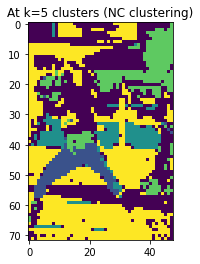

---------------Result Evaluation---------------
F - measure:
------------------------------------
At kmeans:
F-measure at k: 5  and groundTruth segment: 0  is: 0.0973447137640538
F-measure at k: 5  and groundTruth segment: 1  is: 0.10027252375687502
F-measure at k: 5  and groundTruth segment: 2  is: 0.14313171930122479
F-measure at k: 5  and groundTruth segment: 3  is: 0.048739886975674954
F-measure at k: 5  and groundTruth segment: 4  is: 0.07918829577795455
Average at K: 5  is:  0.09373542791515663
------------------------------------
Total Average is:  0.09373542791515663
------------------------------------
At normalized cut:
F-measure at k: 5  and groundTruth segment: 0  is: 0.09954723526732918
F-measure at k: 5  and groundTruth segment: 1  is: 0.0733834853690053
F-measure at k: 5  and groundTruth segment: 2  is: 0.11921758950801849
F-measure at k: 5  and groundTruth segment: 3  is: 0.06613845940347796
F-measure at k: 5  and groundTruth segment: 4  is: 0.07769945368927658
Average 

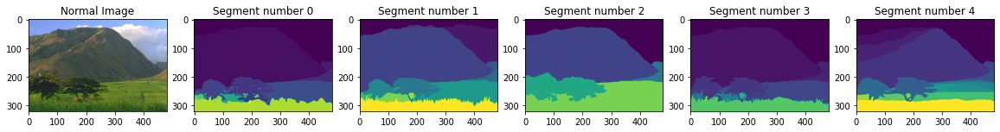

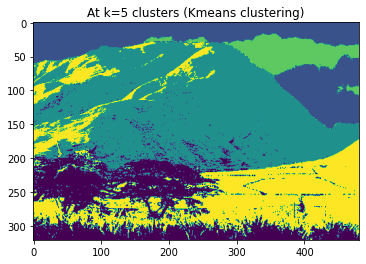

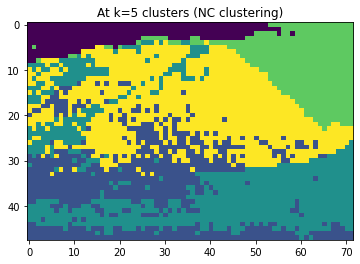

---------------Result Evaluation---------------
F - measure:
------------------------------------
At kmeans:
F-measure at k: 5  and groundTruth segment: 0  is: 0.2280465252387476
F-measure at k: 5  and groundTruth segment: 1  is: 0.26376408195248346
F-measure at k: 5  and groundTruth segment: 2  is: 0.4702798606545629
F-measure at k: 5  and groundTruth segment: 3  is: 0.2200486119818184
F-measure at k: 5  and groundTruth segment: 4  is: 0.2010748133865781
Average at K: 5  is:  0.2766427786428381
------------------------------------
Total Average is:  0.2766427786428381
------------------------------------
At normalized cut:
F-measure at k: 5  and groundTruth segment: 0  is: 0.08724853444502308
F-measure at k: 5  and groundTruth segment: 1  is: 0.23160861546650707
F-measure at k: 5  and groundTruth segment: 2  is: 0.22201021032364984
F-measure at k: 5  and groundTruth segment: 3  is: 0.12779474929624374
F-measure at k: 5  and groundTruth segment: 4  is: 0.168289742931033
Average at K: 5

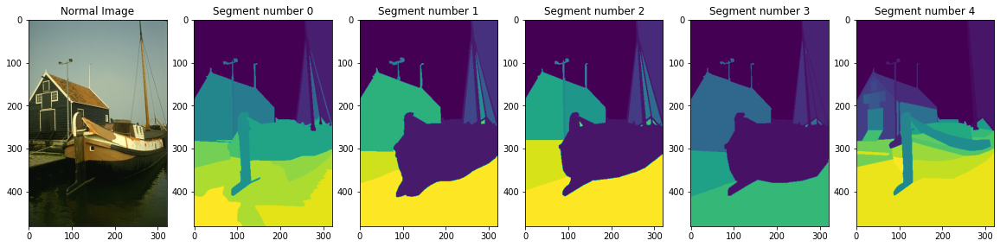

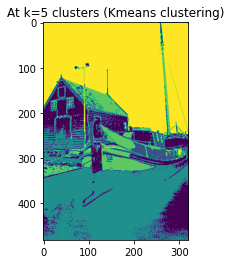

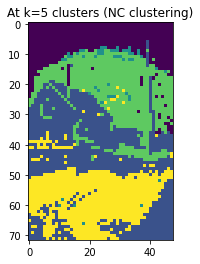

---------------Result Evaluation---------------
F - measure:
------------------------------------
At kmeans:
F-measure at k: 5  and groundTruth segment: 0  is: 0.14138490185743902
F-measure at k: 5  and groundTruth segment: 1  is: 0.24259254518180373
F-measure at k: 5  and groundTruth segment: 2  is: 0.20914943396679533
F-measure at k: 5  and groundTruth segment: 3  is: 0.1826654712088599
F-measure at k: 5  and groundTruth segment: 4  is: 0.07250934165022757
Average at K: 5  is:  0.1696603387730251
------------------------------------
Total Average is:  0.1696603387730251
------------------------------------
At normalized cut:
F-measure at k: 5  and groundTruth segment: 0  is: 0.10128509798186604
F-measure at k: 5  and groundTruth segment: 1  is: 0.15991290673799638
F-measure at k: 5  and groundTruth segment: 2  is: 0.1368169300437126
F-measure at k: 5  and groundTruth segment: 3  is: 0.19503661058438473
F-measure at k: 5  and groundTruth segment: 4  is: 0.08457994467054838
Average at 

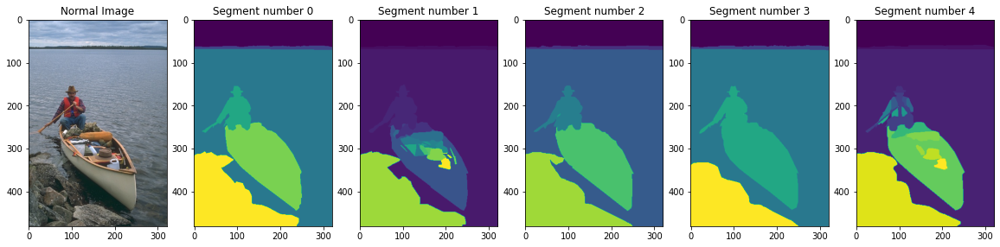

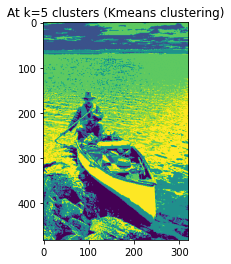

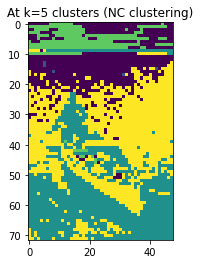

---------------Result Evaluation---------------
F - measure:
------------------------------------
At kmeans:
F-measure at k: 5  and groundTruth segment: 0  is: 0.4847014220040424
F-measure at k: 5  and groundTruth segment: 1  is: 0.19124680534801944
F-measure at k: 5  and groundTruth segment: 2  is: 0.44666992308525505
F-measure at k: 5  and groundTruth segment: 3  is: 0.5161190014011078
F-measure at k: 5  and groundTruth segment: 4  is: 0.22902355831659346
Average at K: 5  is:  0.3735521420310036
------------------------------------
Total Average is:  0.3735521420310036
------------------------------------
At normalized cut:
F-measure at k: 5  and groundTruth segment: 0  is: 0.29046838891690485
F-measure at k: 5  and groundTruth segment: 1  is: 0.13176108042689041
F-measure at k: 5  and groundTruth segment: 2  is: 0.3050587314688963
F-measure at k: 5  and groundTruth segment: 3  is: 0.3273202063334332
F-measure at k: 5  and groundTruth segment: 4  is: 0.18882869180020512
Average at K:

In [ ]:
images=['230098','226060' ,'28083','140088','238025']
k = [5]

for imageIdx,imageName in zip(range(len(images)),images):
  warnings.filterwarnings("ignore")
  print('Image Number:',(imageIdx+1),' Image:',imageName)
  image,segments=displayImage(images[imageIdx])
  segImg=kmeans_clustering(image,k)
  segImgNC = normalizedCut_clustering(image)

  print('---------------Result Evaluation---------------')

  print('F - measure:')
  print('------------------------------------')
  print('At kmeans:')
  F_measure(segImg,segments,k,False)
  print('At normalized cut:')
  F_measure(segImgNC,segments,k,True)

  print('Conditional Entropy:')
  print('------------------------------------')
  print('At kmeans:')
  ConditionalEntropy(segImg,segments,k,False)
  print('At normalized cut:')
  ConditionalEntropy(segImgNC,segments,k,True)

#Extra

In [ ]:
def kmeans_clustering_spatial(image,K):

  dimensions = image.shape
  rgb = image.reshape((-2, 3))
  rgb = np.float32(rgb)
  arr = np.array([
    list(range(dimensions[0]))
    for _ in range(dimensions[1])])
  xs = range(arr.shape[0])
  ys = range(arr.shape[1])
  
  indices = np.array(list(product(ys, xs)))
  indices = np.float32(indices)

  yxrgb = np.append(indices,rgb, axis = 1)
  yxrgb = yxrgb.reshape((-1, 5))
  yxrgb = np.float32(yxrgb)

  segmentedImage=np.zeros((len(K),dimensions[0],dimensions[1]))
  idx=0
  for k in K:
    kmeans = KMeans(n_clusters=k, random_state=0, ).fit(yxrgb)
    segmentedImage[idx] = np.array([j for j in kmeans.labels_]).reshape(dimensions[0],dimensions[1])

    # show the image
    plt.title('At k=5 clusters (kmeans with spatial layout)')
    plt.imshow(segmentedImage[idx])
    plt.show()
    idx += 1
  return segmentedImage

Image Number: 1  Image: 230098


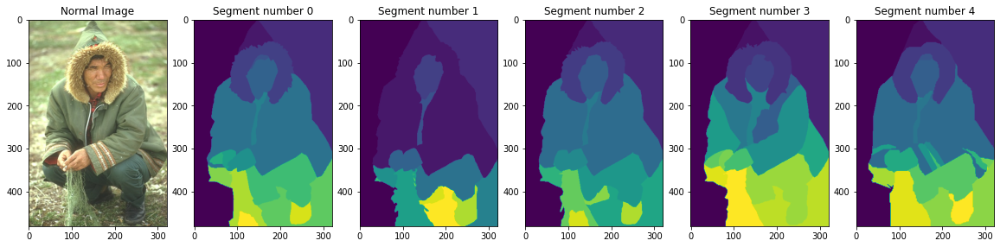

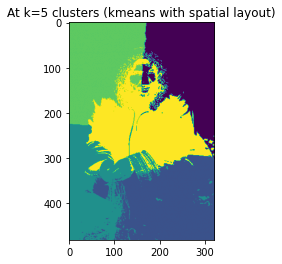

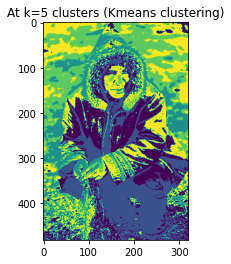

---------------Result Evaluation---------------
F - measure(Kmeans clustering - extra):
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.13340978426281377
F-measure at k: 5  and groundTruth segment: 1  is: 0.16940049598657772
F-measure at k: 5  and groundTruth segment: 2  is: 0.12667476602865854
F-measure at k: 5  and groundTruth segment: 3  is: 0.11104510608395972
F-measure at k: 5  and groundTruth segment: 4  is: 0.14680513976855883
Average at K: 5  is:  0.1374670584261137
------------------------------------
Total Average is:  0.1374670584261137
------------------------------------
F - measure(Kmeans clustering):
F-measure at k: 5  and groundTruth segment: 0  is: 0.20826006120496673
F-measure at k: 5  and groundTruth segment: 1  is: 0.1979385126203977
F-measure at k: 5  and groundTruth segment: 2  is: 0.19887072235949296
F-measure at k: 5  and groundTruth segment: 3  is: 0.17460447164075144
F-measure at k: 5  and groundTruth segment: 4  is: 0

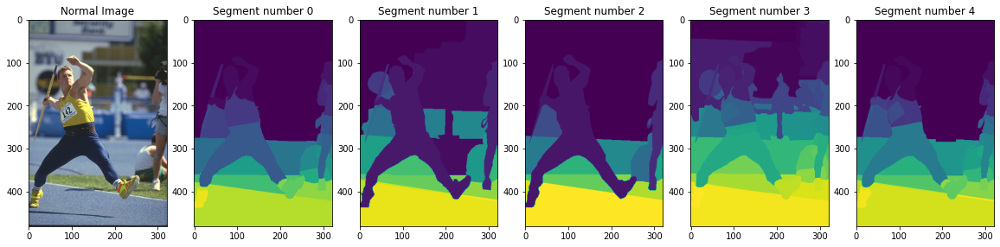

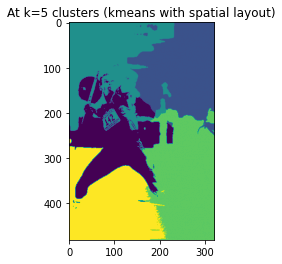

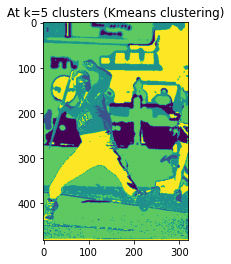

---------------Result Evaluation---------------
F - measure(Kmeans clustering - extra):
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.10041262808908047
F-measure at k: 5  and groundTruth segment: 1  is: 0.07390377293085389
F-measure at k: 5  and groundTruth segment: 2  is: 0.20049698478530084
F-measure at k: 5  and groundTruth segment: 3  is: 0.0416177332277775
F-measure at k: 5  and groundTruth segment: 4  is: 0.08628534774222046
Average at K: 5  is:  0.10054329335504661
------------------------------------
Total Average is:  0.10054329335504661
------------------------------------
F - measure(Kmeans clustering):
F-measure at k: 5  and groundTruth segment: 0  is: 0.0973447137640538
F-measure at k: 5  and groundTruth segment: 1  is: 0.10027252375687502
F-measure at k: 5  and groundTruth segment: 2  is: 0.14313171930122479
F-measure at k: 5  and groundTruth segment: 3  is: 0.048739886975674954
F-measure at k: 5  and groundTruth segment: 4  is:

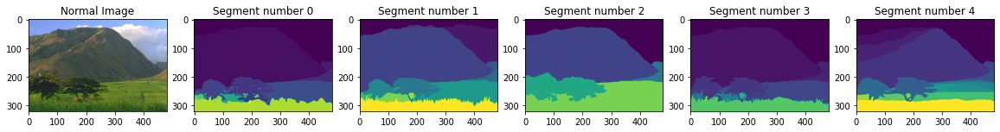

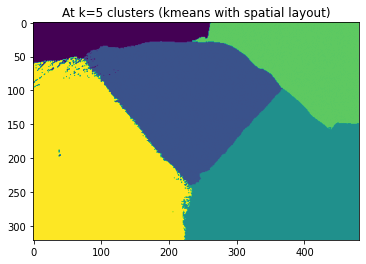

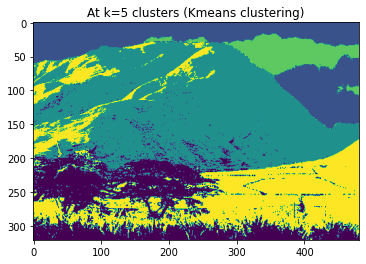

---------------Result Evaluation---------------
F - measure(Kmeans clustering - extra):
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.08409044999936656
F-measure at k: 5  and groundTruth segment: 1  is: 0.16118932467497876
F-measure at k: 5  and groundTruth segment: 2  is: 0.3320685259001189
F-measure at k: 5  and groundTruth segment: 3  is: 0.17451313314714345
F-measure at k: 5  and groundTruth segment: 4  is: 0.10752301579231734
Average at K: 5  is:  0.171876889902785
------------------------------------
Total Average is:  0.171876889902785
------------------------------------
F - measure(Kmeans clustering):
F-measure at k: 5  and groundTruth segment: 0  is: 0.2280465252387476
F-measure at k: 5  and groundTruth segment: 1  is: 0.26376408195248346
F-measure at k: 5  and groundTruth segment: 2  is: 0.4702798606545629
F-measure at k: 5  and groundTruth segment: 3  is: 0.2200486119818184
F-measure at k: 5  and groundTruth segment: 4  is: 0.2010

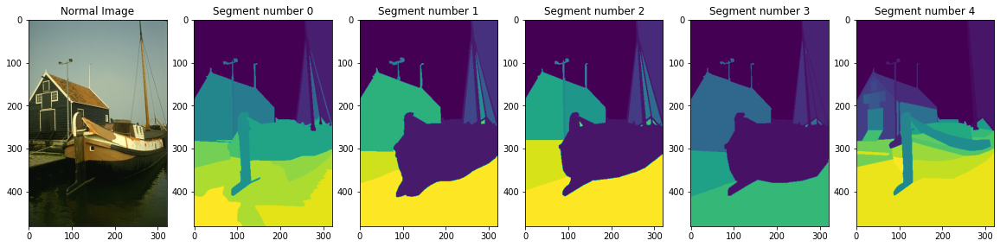

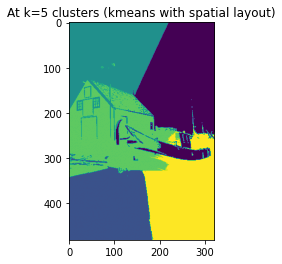

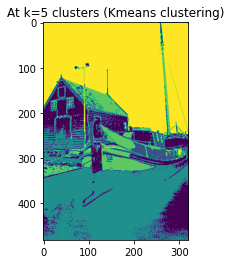

---------------Result Evaluation---------------
F - measure(Kmeans clustering - extra):
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.07342657342657344
F-measure at k: 5  and groundTruth segment: 1  is: 0.11478629120036477
F-measure at k: 5  and groundTruth segment: 2  is: 0.09842906728282474
F-measure at k: 5  and groundTruth segment: 3  is: 0.08253029821883519
F-measure at k: 5  and groundTruth segment: 4  is: 0.05529953917050691
Average at K: 5  is:  0.084894353859821
------------------------------------
Total Average is:  0.084894353859821
------------------------------------
F - measure(Kmeans clustering):
F-measure at k: 5  and groundTruth segment: 0  is: 0.14138490185743902
F-measure at k: 5  and groundTruth segment: 1  is: 0.24259254518180373
F-measure at k: 5  and groundTruth segment: 2  is: 0.20914943396679533
F-measure at k: 5  and groundTruth segment: 3  is: 0.1826654712088599
F-measure at k: 5  and groundTruth segment: 4  is: 0.0

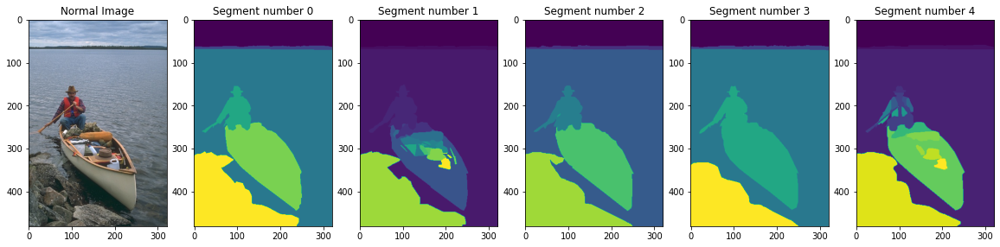

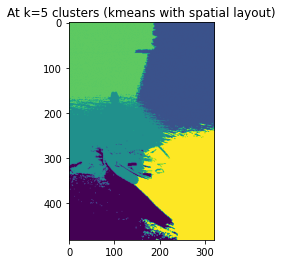

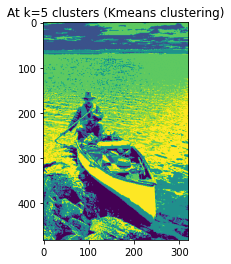

---------------Result Evaluation---------------
F - measure(Kmeans clustering - extra):
------------------------------------
F-measure at k: 5  and groundTruth segment: 0  is: 0.2935863428275746
F-measure at k: 5  and groundTruth segment: 1  is: 0.10504960394808976
F-measure at k: 5  and groundTruth segment: 2  is: 0.2691872195377858
F-measure at k: 5  and groundTruth segment: 3  is: 0.349552192362172
F-measure at k: 5  and groundTruth segment: 4  is: 0.12941986777558037
Average at K: 5  is:  0.22935904529024054
------------------------------------
Total Average is:  0.22935904529024054
------------------------------------
F - measure(Kmeans clustering):
F-measure at k: 5  and groundTruth segment: 0  is: 0.4847014220040424
F-measure at k: 5  and groundTruth segment: 1  is: 0.19124680534801944
F-measure at k: 5  and groundTruth segment: 2  is: 0.44666992308525505
F-measure at k: 5  and groundTruth segment: 3  is: 0.5161190014011078
F-measure at k: 5  and groundTruth segment: 4  is: 0.22

In [ ]:
images=['230098','226060','28083','140088','238025']
k = [5]

for imageIdx,imageName in zip(range(len(images)),images):
  warnings.filterwarnings("ignore")

  print('Image Number:',(imageIdx+1),' Image:',imageName)

  image,segments=displayImage(images[imageIdx]) 
  segImg_extra=kmeans_clustering_spatial(image,k)
  segImg=kmeans_clustering(image,k)

  print('---------------Result Evaluation---------------')

  print('F - measure(Kmeans clustering - extra):')
  print('------------------------------------')
  F_measure(segImg_extra,segments,k,False)
  print('F - measure(Kmeans clustering):')
  F_measure(segImg,segments,k,False)

  print('Conditional Entropy(Kmeans clustering - extra):')
  print('------------------------------------')
  ConditionalEntropy(segImg_extra,segments,k,False)
  print('Conditional Entropy(Kmeans clustering):')
  ConditionalEntropy(segImg,segments,k,False)
